# ATAC annotation using Scanpy

In [1]:
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

from matplotlib import colors

import os
import anndata

In [2]:
sc.logging.print_header()

scanpy==1.7.2 anndata==0.7.6 umap==0.5.1 numpy==1.20.3 scipy==1.7.1 pandas==1.2.5 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 louvain==0.7.0


In [3]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                    ipython_format='png2x', figsize=(8,8))

In [4]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,3))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [5]:
os.getcwd()

'/home/jovyan'

In [6]:
os.chdir('proc_data/s1d1/')

## Load data

In [7]:
# Load data preprocessed with Signac
adata_atac = sc.read_h5ad('adata_geneAct.h5ad')

In [8]:
adata_atac

AnnData object with n_obs × n_vars = 7985 × 19039
    obs: 'nCount_peaks', 'atac_fragments', 'TSS.enrichment', 'reads_in_peaks_frac', 'blacklist_fraction', 'nucleosome_signal'
    obsm: 'lsi_full', 'lsi_red', 'peaks', 'umap'

**ATAC Marker genes**

In [152]:
marker_genes = {
    'CD14+ Mono': ['TREM1', 'FPR1'],
    'CD16+ Mono': ['LYN', 'TCF7L2'],
    'ID2-hi myeloid prog': ['KLF4'],
    'cDC2': ['TREM1', 'DMXL2'], # Note: DMXL2 should be negative
    'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
    'Erythroblast': ['GATA1', 'MKI67'],
    'Proerythroblast': ['GATA2', 'SYNGR1'],
    'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
    'ILC': ['SPON2', 'GZMB', 'PRF1'], # Note CD69 should be negative
    'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
    'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
    'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
    'Transitional B': ['MME', 'CD38', 'CD24'],
    'Plasma cells': ['DUSP22', 'FNDC3B'],
    'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
    'CD4+ T naive': [ 'BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'], # Note JAKMIP1 and C4orf50 are negative markers
    'CD8+ T': ['CD8A', 'CD8B'],
    'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
    'HSPC/Mono prog': ['MPO','NT5DC3'],
    'HSC': ['PRDM16','MTRNR2L1'],
    'MK/E prog': ['DNAJC6']
}

# Due to the QC and thresholding issue, some marker genes were filtered out. We're keeping notes here for further usage.
# Proerythroblasts : CRACD
# HSC : TAMALIN
# ILC : C69 (negative marker)


## Clustering

Choose the reduced set of LSI components stored in adata.obsm.lsi_red and cluster on various resolutions.

In [10]:
sc.pp.neighbors(adata_atac, use_rep = 'lsi_red')

In [11]:
sc.tl.leiden(adata_atac, resolution=0.3, key_added='leiden_res0.3')
sc.tl.leiden(adata_atac, resolution=0.5, key_added='leiden_res0.5')
sc.tl.leiden(adata_atac, resolution=0.8, key_added='leiden_res0.8')
sc.tl.leiden(adata_atac, resolution=1, key_added='leiden_res1')

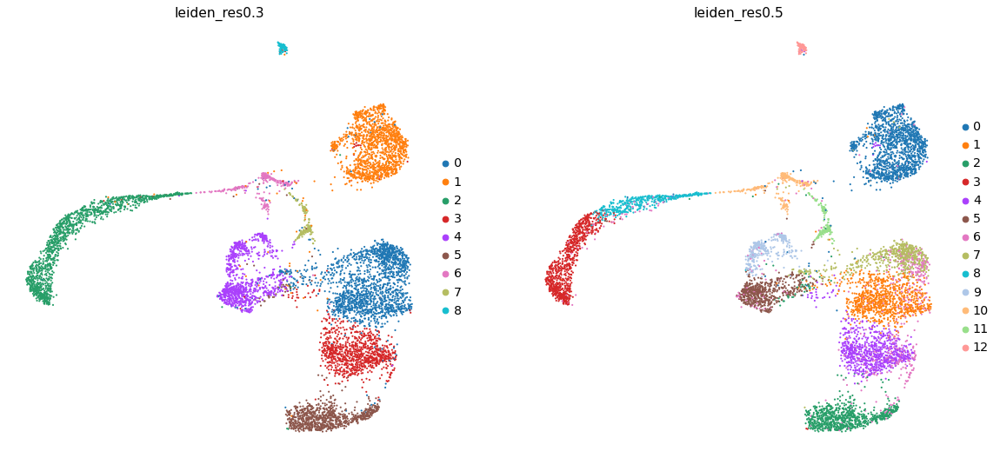

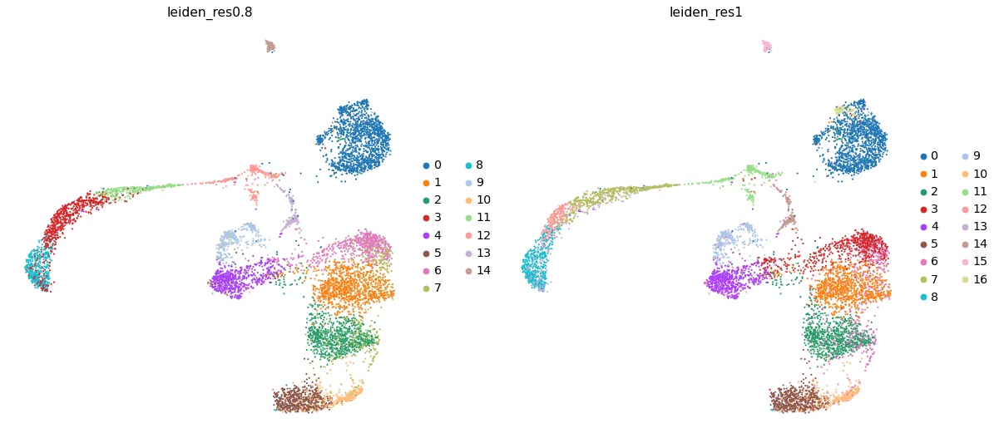

In [12]:
sc.pl.umap(adata_atac, color=['leiden_res0.3', 'leiden_res0.5'])
sc.pl.umap(adata_atac, color=['leiden_res0.8', 'leiden_res1'])

Choose rather coarse resolution that captures the main clusters (here: 0.5)

## QC and marker gene overview

In [13]:
# Select column that should be visualized
leiden_clus_col = 'leiden_res0.5'
# Name for added ranked genes per group
rank_id = 'rank_genes_res0.5'

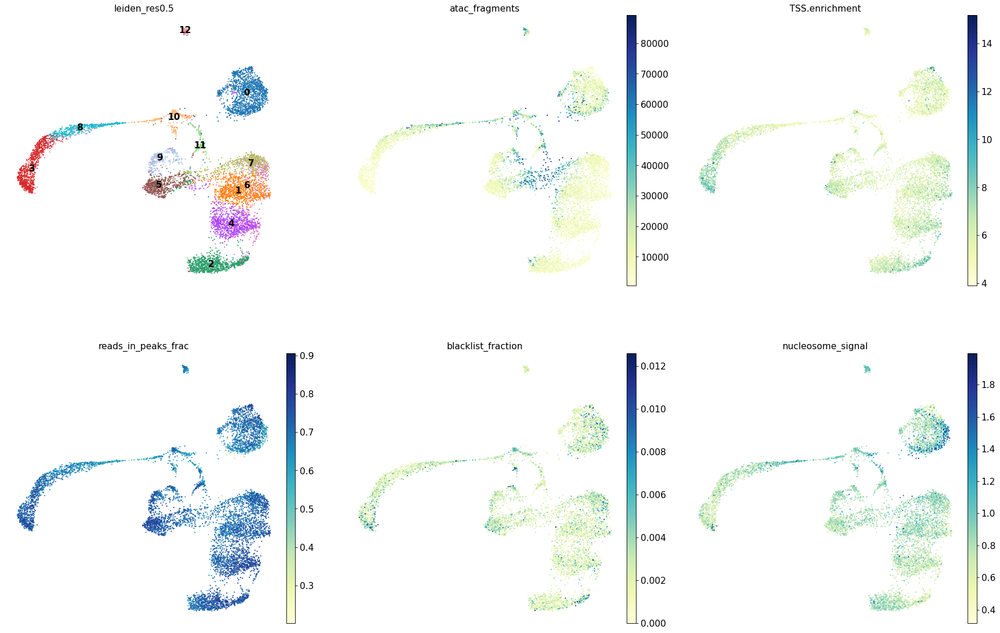

In [14]:
sc.pl.umap(adata_atac, color=[leiden_clus_col, 'atac_fragments', 'TSS.enrichment',
                              'reads_in_peaks_frac','blacklist_fraction','nucleosome_signal'],
          legend_loc = 'on data',
          ncols=3)

In [15]:
sc.tl.rank_genes_groups(adata_atac,
                        groupby= leiden_clus_col,
                        key_added = rank_id)

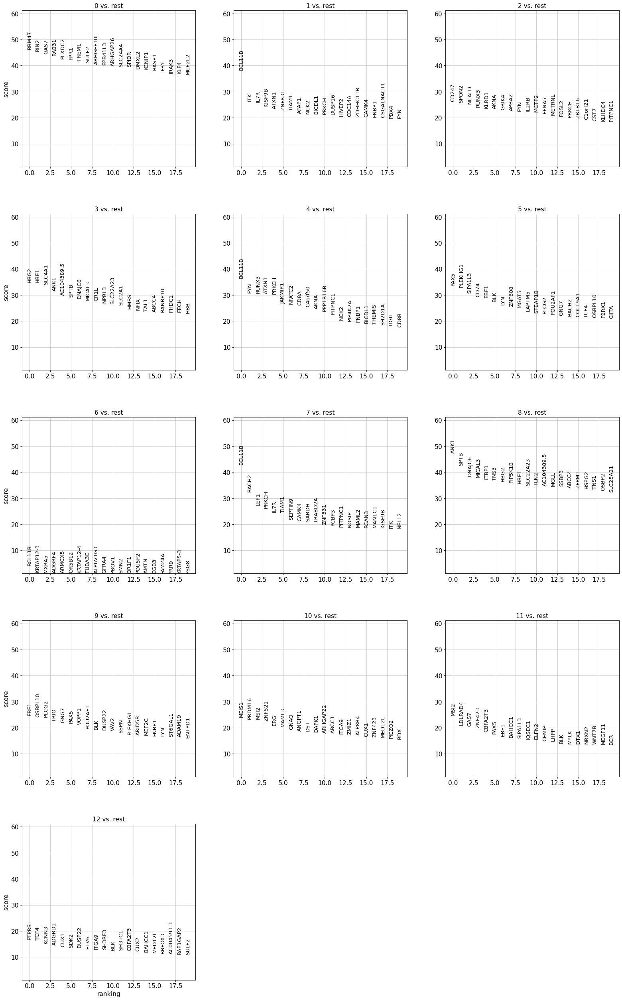

In [16]:
sc.pl.rank_genes_groups(adata_atac, key = rank_id, ncols=3, fontsize=12)

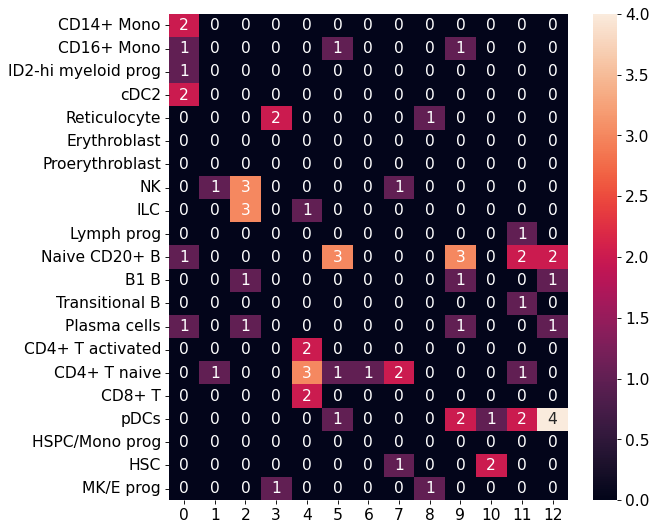

In [153]:
sns.heatmap(sc.tl.marker_gene_overlap(adata_atac,
                                      reference_markers=marker_genes,
                                      key= rank_id), annot=True)

plt.show()

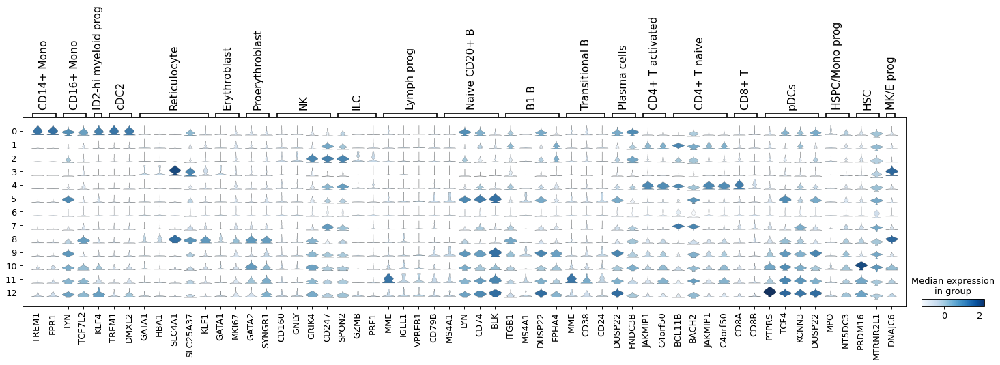

In [154]:
# Reduce to marker genes in gene activity matrix
filt_marker_genes = dict()
for key,val in marker_genes.items():
    filt_vals = [i for i in val if i in adata_atac.var_names]
    filt_marker_genes[key] = filt_vals

# Scale and plot
adata_plot = adata_atac.copy()
sc.pp.scale(adata_plot, max_value=5)
    
sc.pl.stacked_violin(adata_plot, var_names = filt_marker_genes,
                     groupby= leiden_clus_col,
                     use_raw=False)

In [155]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'pDCs', 'HSPC/Mono prog', 'HSC', 'MK/E prog'])

In [156]:
# Initial clustering:

init_clus_dict = {
    
    '0':['CD 14+ Mono','CD 16+ Mono','cDC2','ID2-hi myeloid prog'], # DMXL2 is not negative...but this TREM1 is the strongest in here.
    '1':['CD4+ T'],
    '2':['NK', 'ILC', ],
    '3':['Reticulocyte', 'MK/E prog'],
    '4':['CD4+ T', 'CD8+ T'],
    '5':['Naive CD20+ B'],
    '6':['CD4 + T'], # very weak expression for all genes...probably a doublet?
    '7':['CD4 + T', 'HSC'],
    '8':['Proerythroblast','Reticulocyte'],
    '9':['Naive CD20+ B','B1 B'],
    '10':['Proerythroblast','HSC'],
    '11':['Naive CD20+ B', 'Transitional B' 'pDCs'],
    '12':['CD 16+ Mono','ID2-hi myeloid prog','Naive CD20+ B','pDCs']

}

# This initial clustering is based upon the violin plot above, thus preliminary.

### Plot marker genes

Check whether marker gene expression gives hint to subclusters of initial clusters.

Some marker genes are negative: DMXL2 for cDC2; CD69 for ILCs; JAKMIP1 and C4orf50 for naive T cells.

Due to the sparsity of the ATAC data, increased gene activity is not always very obivios. Try to keep keep clear markers for other celltypes in mind.

Cluster: CD14+ Mono


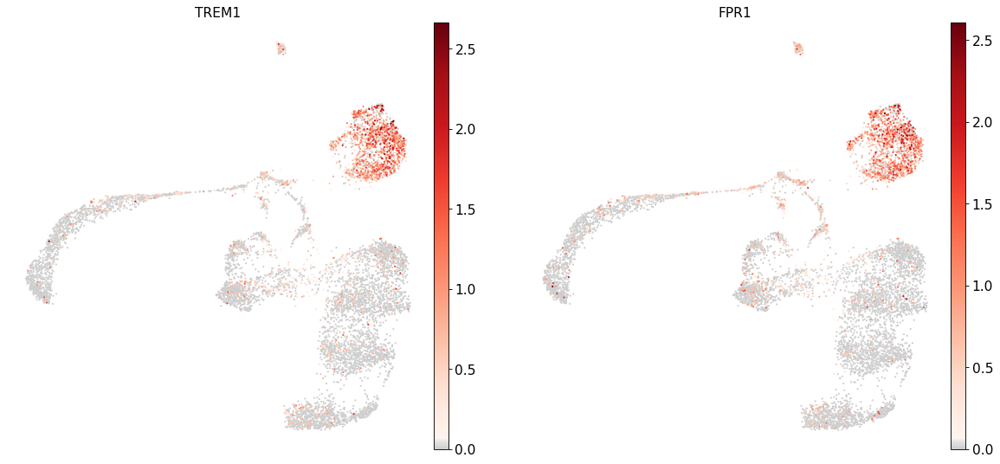

Cluster: CD16+ Mono


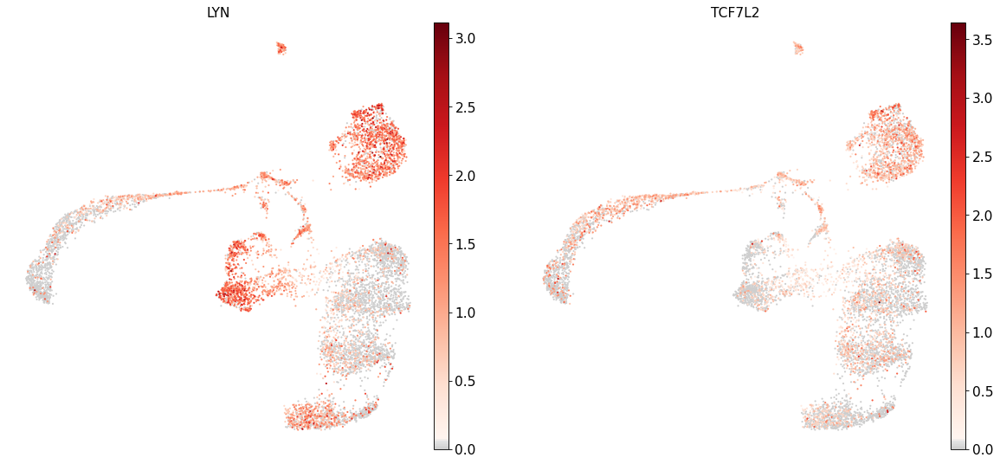

Cluster: CD14+ Mono prog


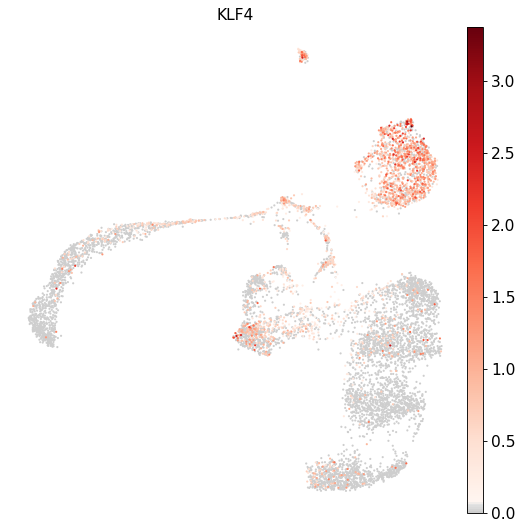

Cluster: cDC2


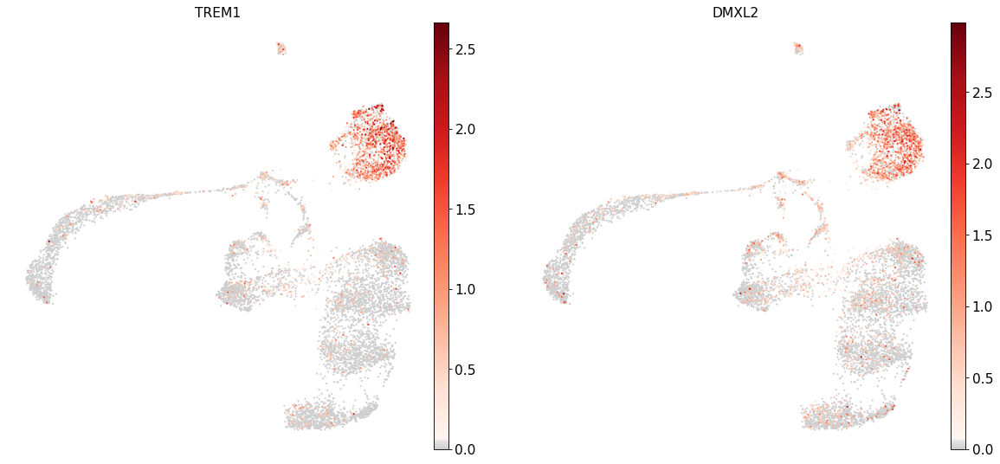

Cluster: Reticulocyte


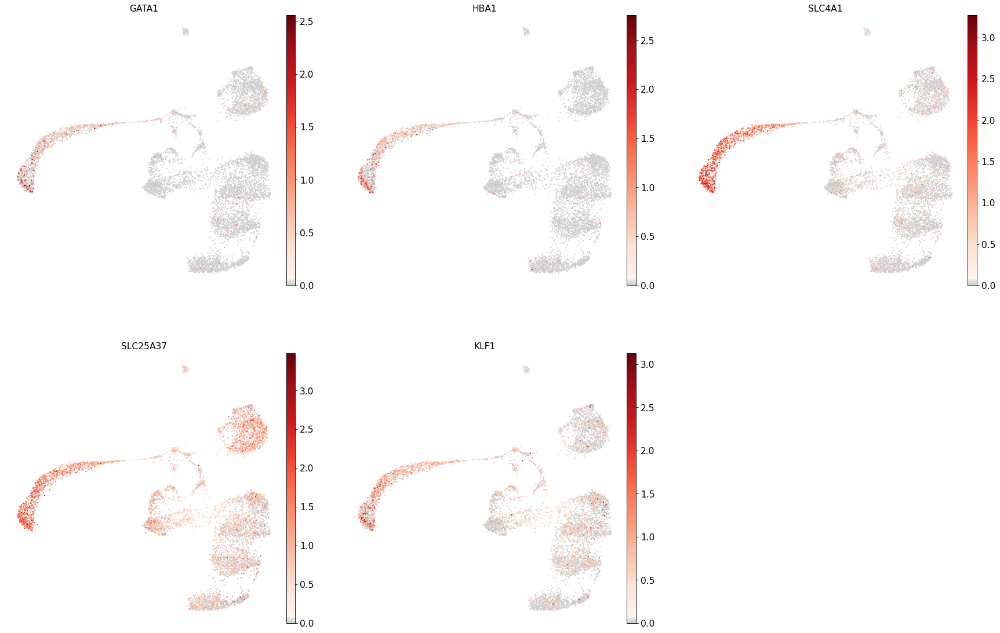

Cluster: Erythroblast


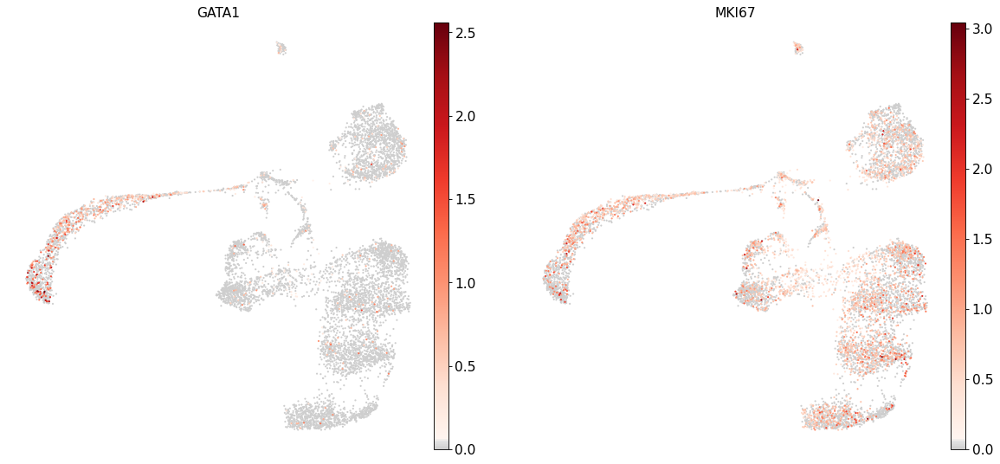

Cluster: Proerythroblast


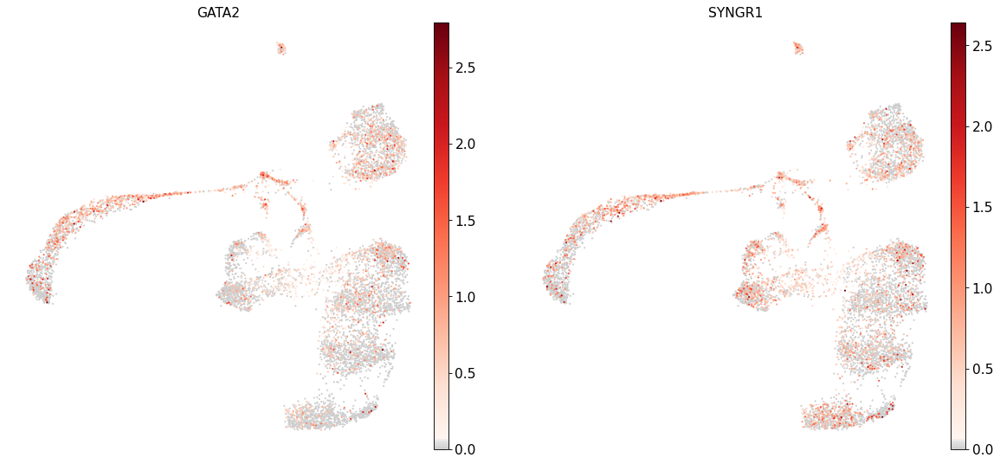

Cluster: NK


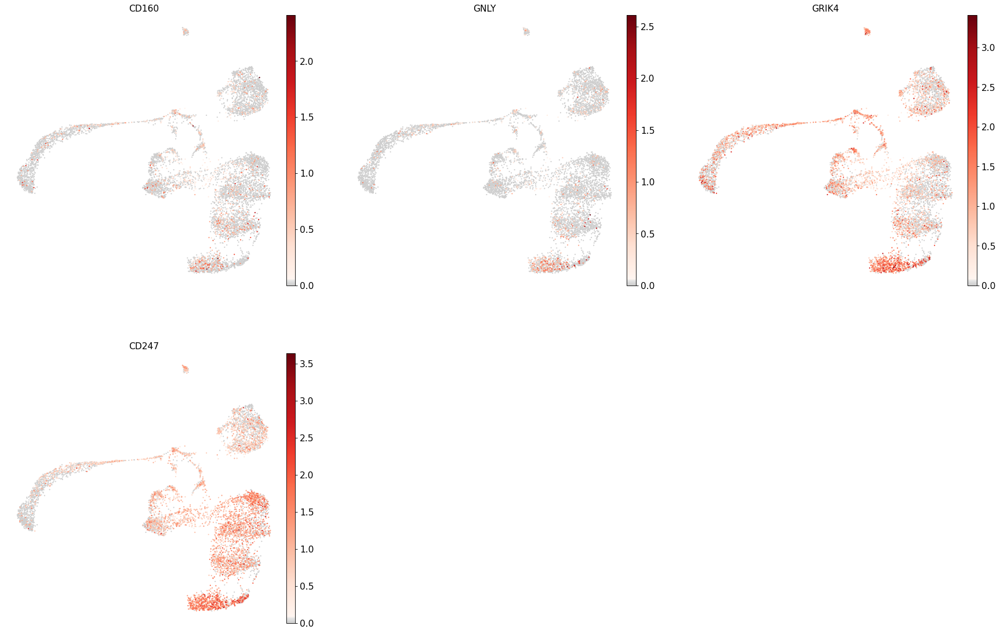

Cluster: ILC


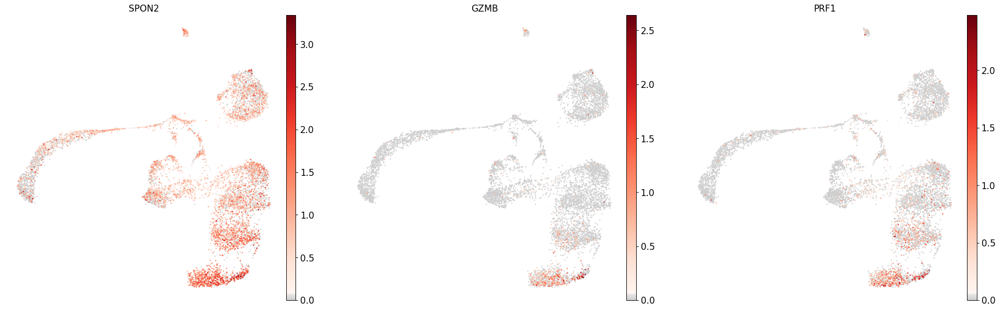

Cluster: Lymph prog


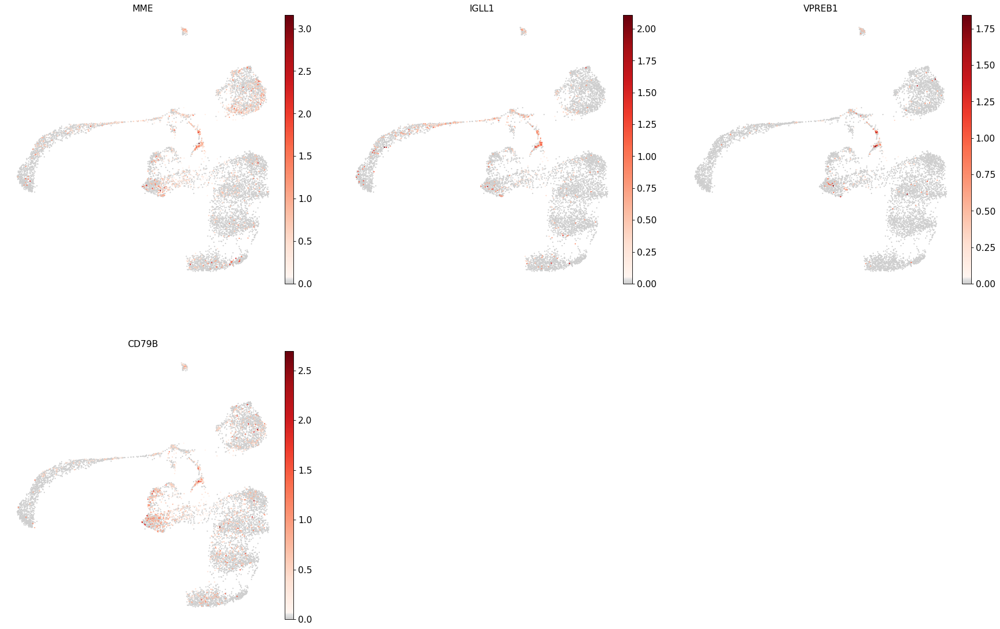

Cluster: Naive CD20+ B


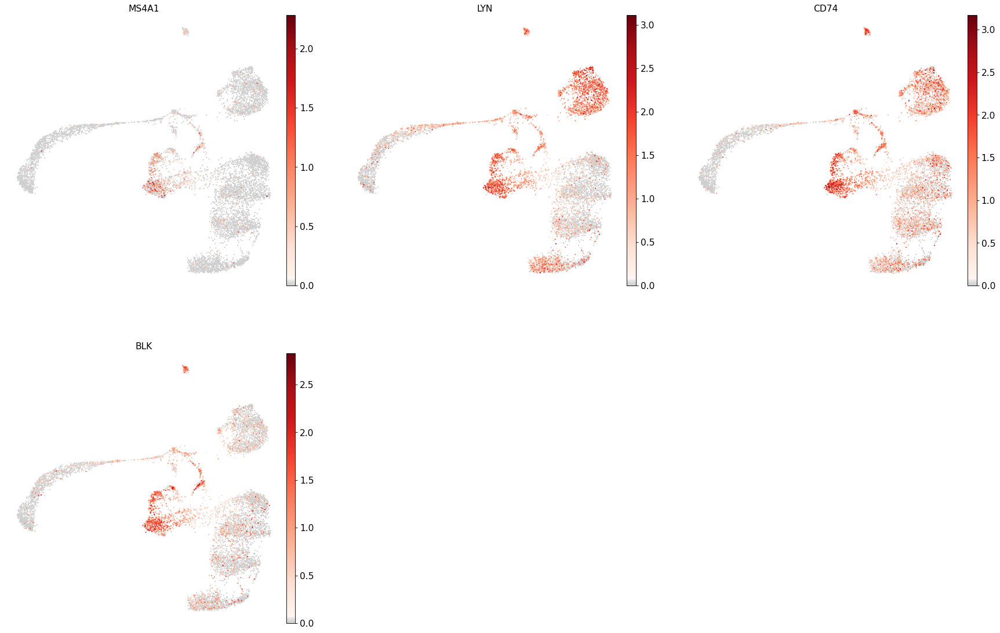

Cluster: B1 B


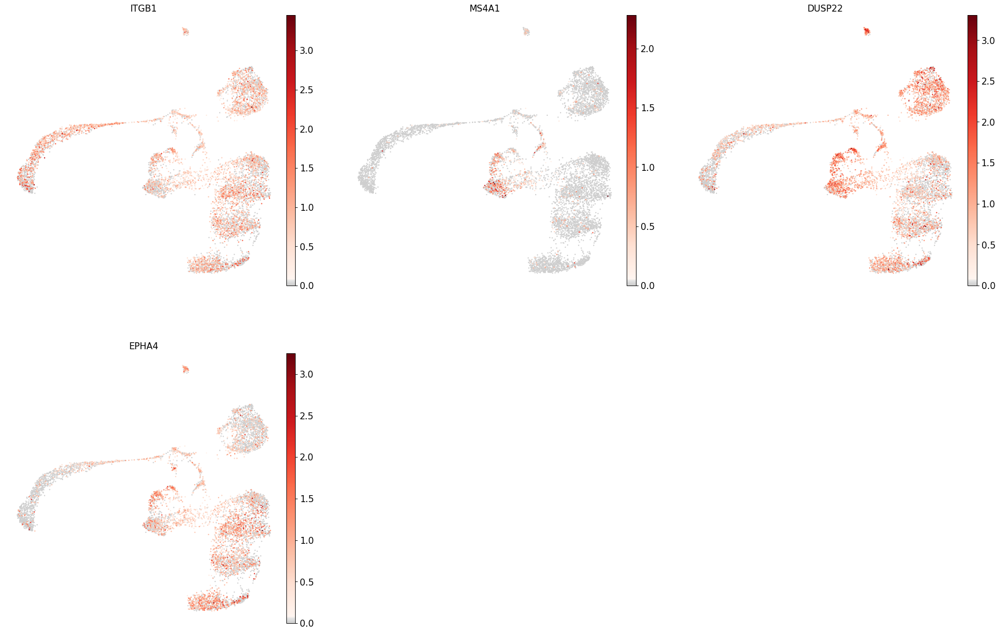

Cluster: Transitional B


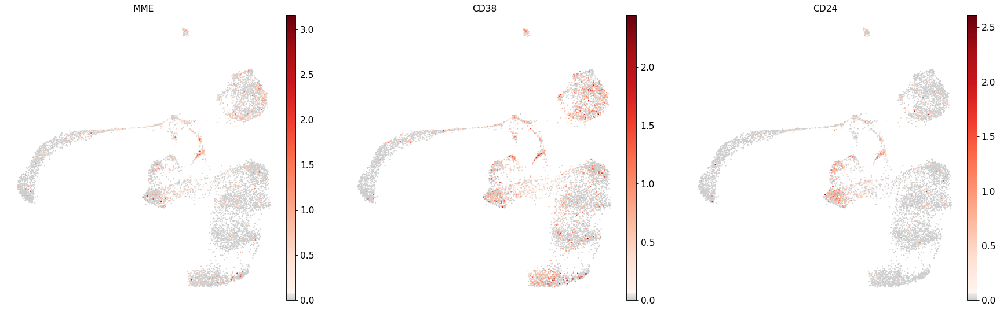

Cluster: Plasma cells


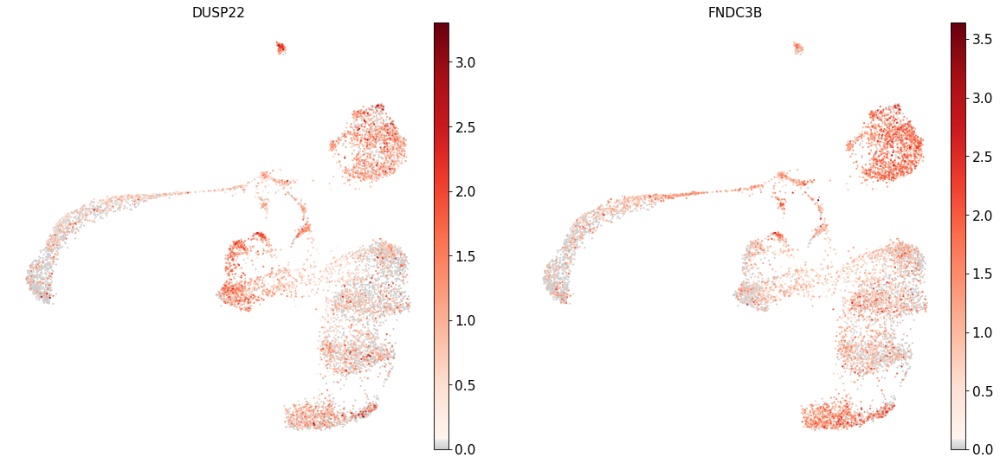

Cluster: CD4+ T activated


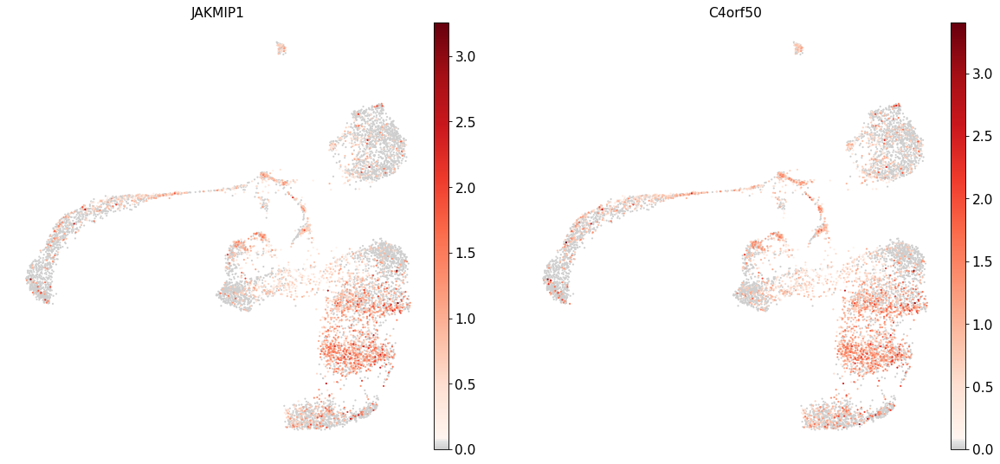

Cluster: CD4+ T naive


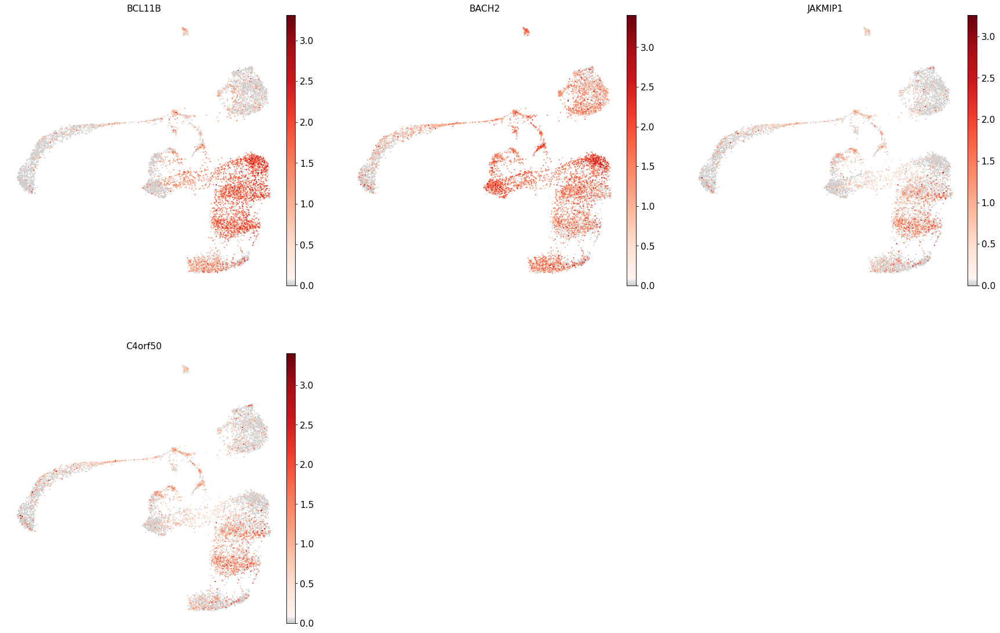

Cluster: CD8+ T


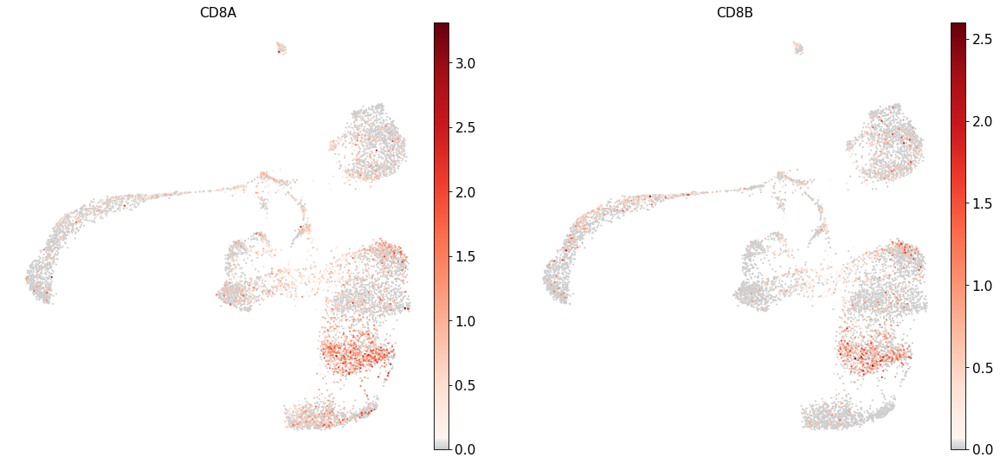

Cluster: pDCs


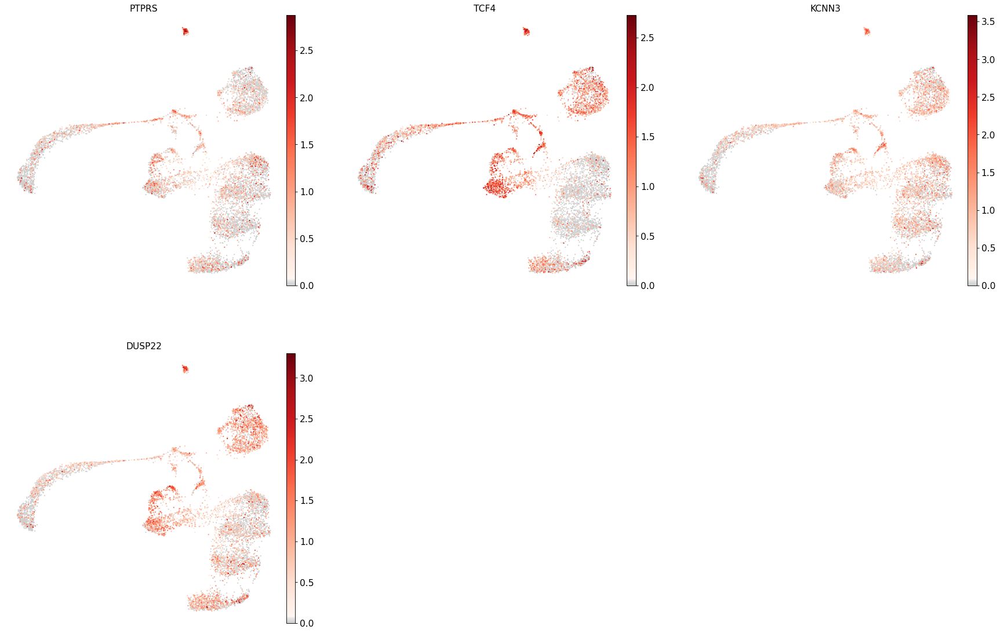

Cluster: HSPC/Mono prog


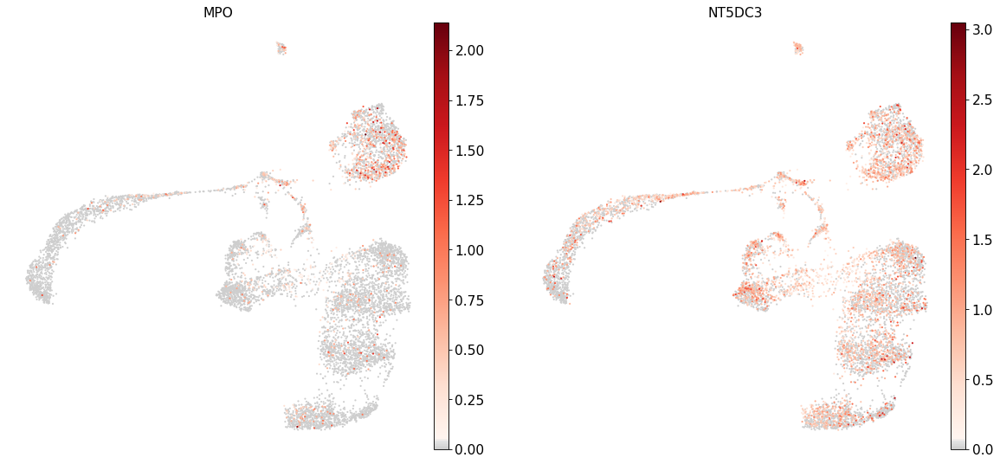

Cluster: HSC


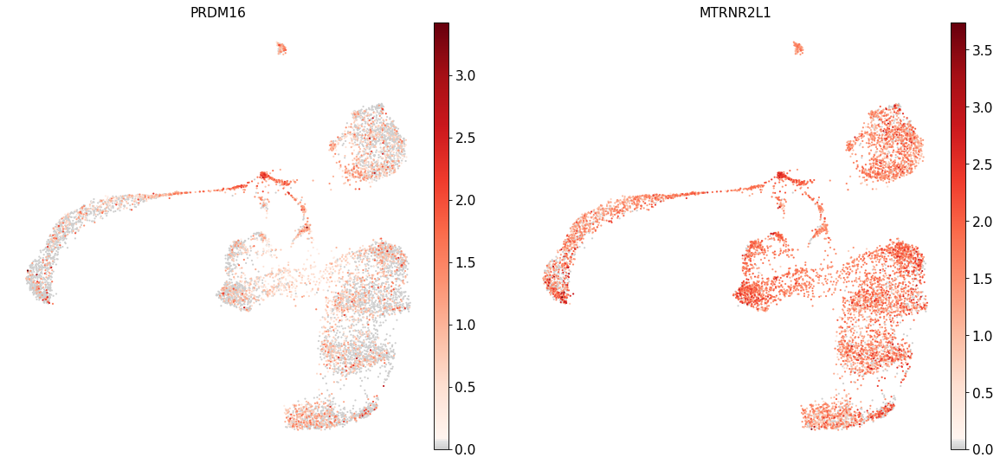

Cluster: MK/E prog


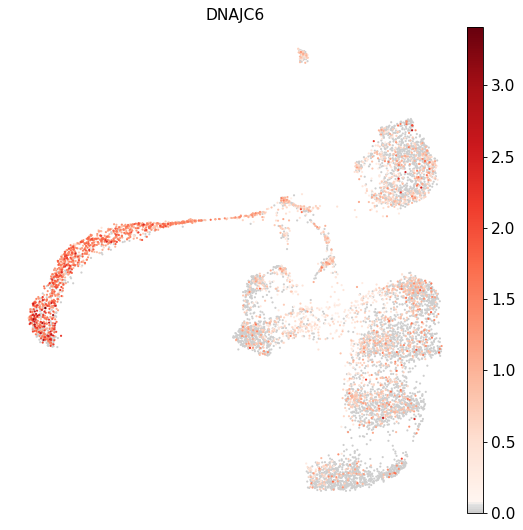

In [21]:
for i in marker_genes.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in marker_genes[i] if i in adata_atac.var_names]
    sc.pl.umap(adata_atac, color=genes_to_plot, ncols=3, use_raw=False, cmap=mymap)

Marker genes suggest:
- 0: CD 14+ Mono, CD 16+ Mono, cDC2, CD14+ Mono prog
- 1: CD4+ T
- 2: NK, ILC
- 3: Reticulocyte, MK/E prog
- 4: CD4+ T, CD8+ T
- 5: Naive CD20+ B
- 6: CD4 + T (very weak expression for all genes...probably a doublet?)
- 7: CD4 + T and HSC
- 8: Proerythroblast, Reticulocyte
- 9: Naive CD20+ B, B1 B
- 10: CD 16+ Mono, CD14+ Mono prog, HSC
- 11: Naive CD20+ B, Transitional B, pDCs
- 12: CD 16+ Mono, CD14+ Mono prog, Naive CD20+ B, pDCs



In [22]:
# Based on the UMAP, we adjusted our initial guess for the cluster identities

# Initial clustering:

init_clus_dict = {
    
    '0':['CD 14+ Mono','CD 16+ Mono','cDC2','CD14+ Mono prog'], 
    '1':['CD4+ T'],
    '2':['NK', 'ILC', ],
    '3':['Reticulocyte', 'MK/E prog'],
    '4':['CD4+ T', 'CD8+ T'],
    '5':['Naive CD20+ B'],
    '6':['CD4 + T'], # very weak expression for all genes...probably a doublet?
    '7':['CD4 + T', 'HSC'],
    '8':['Proerythroblast','Reticulocyte'],
    '9':['Naive CD20+ B','B1 B'],
    '10':['CD 16+ Mono','CD14+ Mono prog','Proerythroblast','HSC'],
    '11':['Naive CD20+ B', 'Transitional B', 'pDCs'],
    '12':['CD 16+ Mono','CD14+ Mono prog','Naive CD20+ B','pDCs']

}



# Subclustering

Subclustering can be done by considering the marker genes and clustering of clear substructure in the data. Here we go through the clusters based on the major cell types identified above.


## Monocytes and DCs

In [23]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'CD14+ Mono prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'HSPC/Mono prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

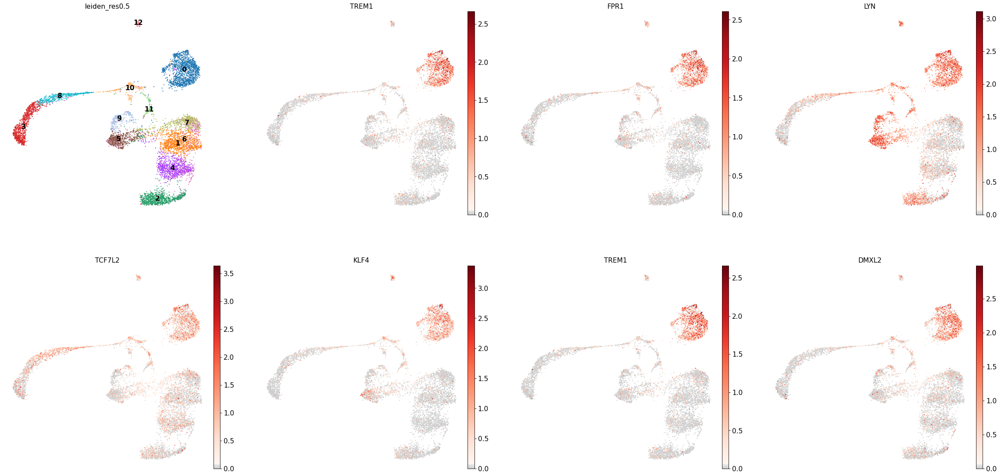

In [24]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = [leiden_clus_col]+
              marker_genes['CD14+ Mono']+
              marker_genes['CD16+ Mono']+
              marker_genes['CD14+ Mono prog']+
              marker_genes['cDC2']
          )

### cluster 0

In [157]:
c_id = 0

In [158]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD 14+ Mono', 'CD 16+ Mono', 'cDC2', 'ID2-hi myeloid prog']

Here, we try to split the sub-structures and see whether they have differential accessibility level between sub-structures

For this **first** split, we use the leiden_clus_col as a starting point, for subsequent splits we use the newly generated column to get a final clustering in the end. For testing the correct resolution for each cluster we further work with a temporary cluster column.

In [159]:
# Once the resolution looks good change new_key to leiden final
orig_key = leiden_clus_col
#new_key = 'leiden_temp'
new_key = 'leiden_sub' 
new_rg_key = 'rg_tsub'
sub_key = str(c_id)

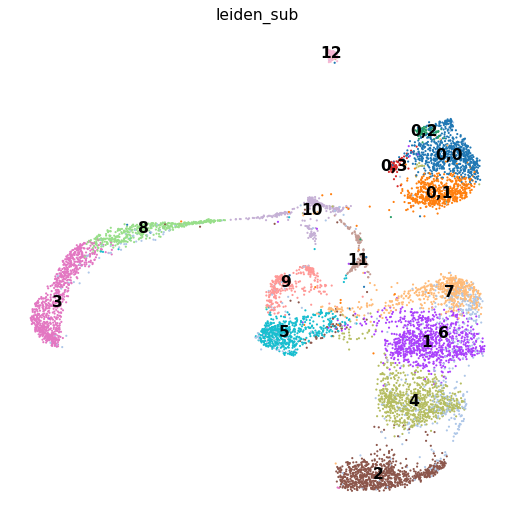

1      924
2      889
3      859
4      824
0,0    731
5      607
6      604
7      550
0,1    539
8      453
9      329
10     258
11     181
12     105
0,2     73
0,3     59
Name: leiden_sub, dtype: int64

In [179]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


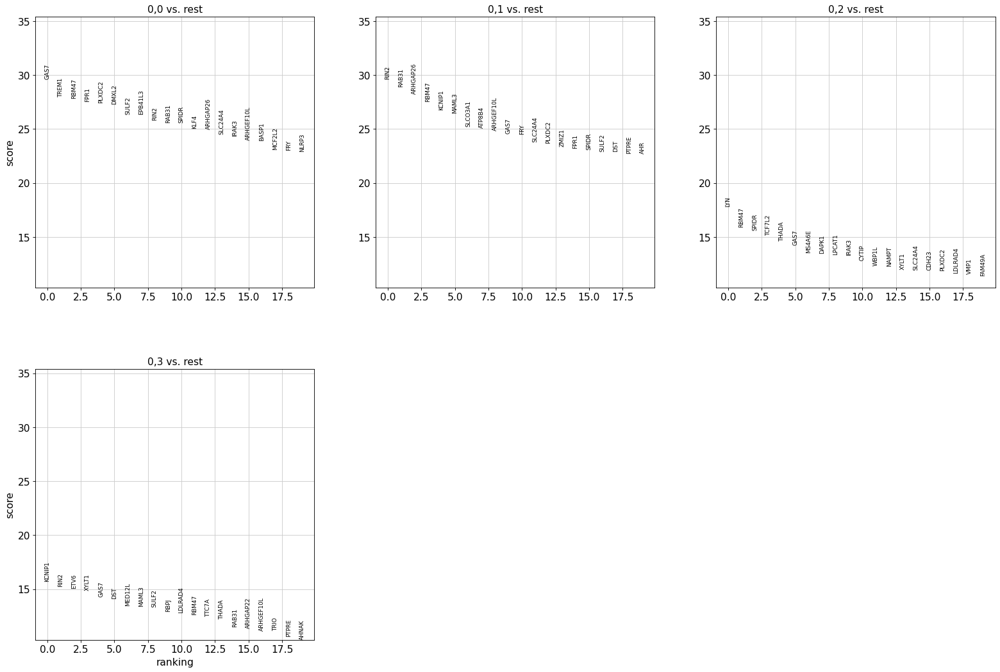

In [181]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 4

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

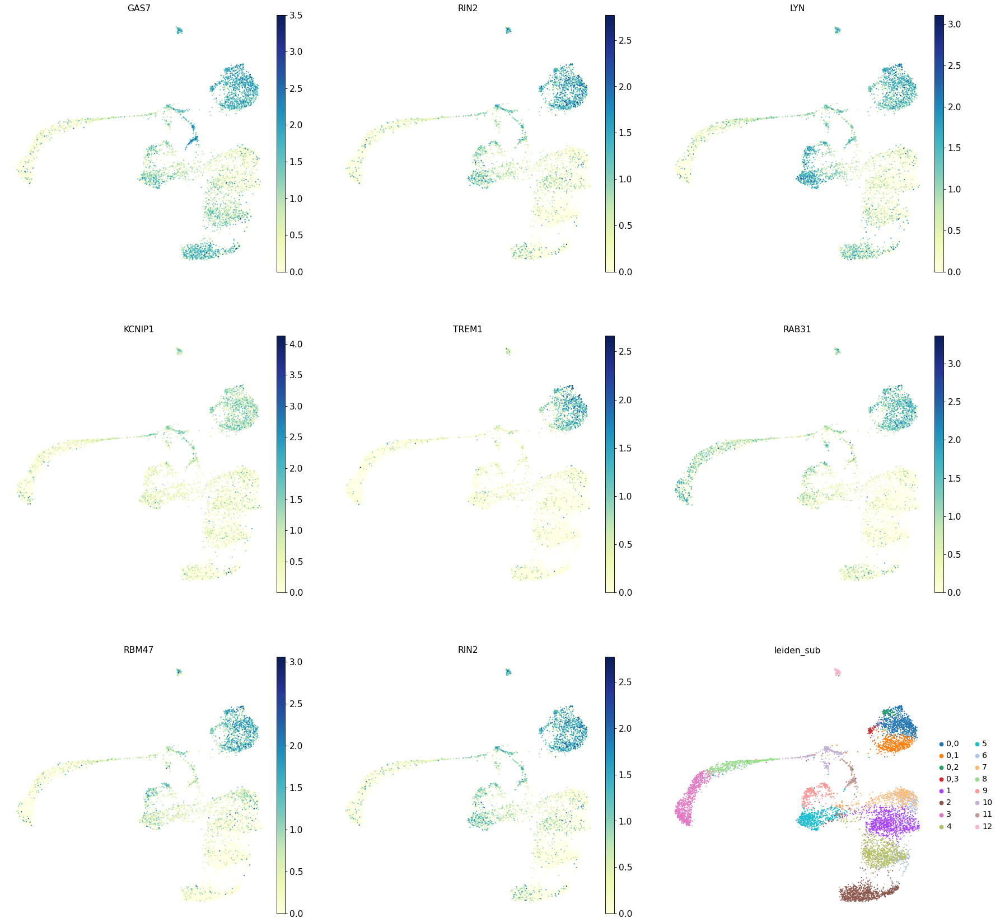

In [182]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

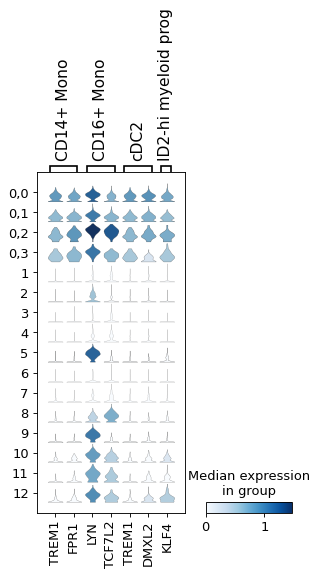

In [183]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'ID2-hi myeloid prog']}, groupby=new_key)

#### Conclusion
- 0,0: CD14+ Mono, ID2-hi myeloid prog
- 0,1: CD14+ Mono, ID2-hi myeloid prog
- 0,2: CD14+ Mono, CD16+ Mono
- 0,3: CD14+ Mono, cDC2 (lower DMXL2 level)

## Progenitors (HSC/Mono) - cluster 10

In [184]:
c_id = 10

In [185]:
# Initial assignment
init_clus_dict[str(c_id)]

['Proerythroblast', 'HSC']

For this **second and subsequent** splits, we use the newly generated column.

In [186]:
# Once the resolution looks good change new_key to leiden_sub
orig_key = 'leiden_sub'
#new_key = 'leiden_temp'
new_key = 'leiden_res0.5_msub'
new_rg_key = 'rg_msub'
sub_key = str(c_id)


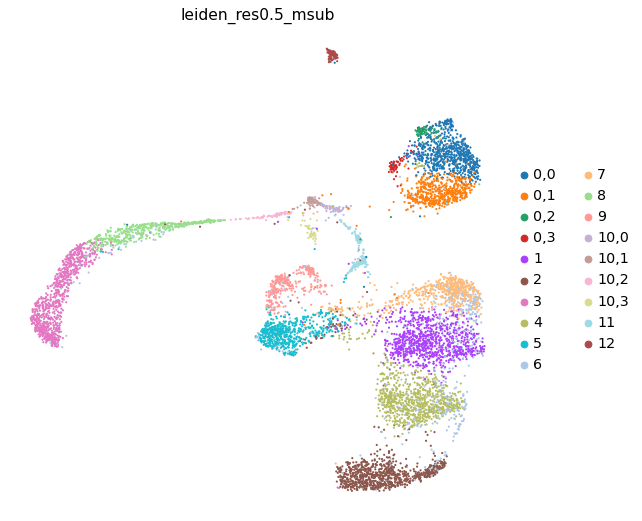

1       924
2       889
3       859
4       824
0,0     731
5       607
6       604
7       550
0,1     539
8       453
9       329
11      181
12      105
10,0     75
0,2      73
10,1     71
10,2     61
0,3      59
10,3     51
Name: leiden_res0.5_msub, dtype: int64

In [187]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key)#, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


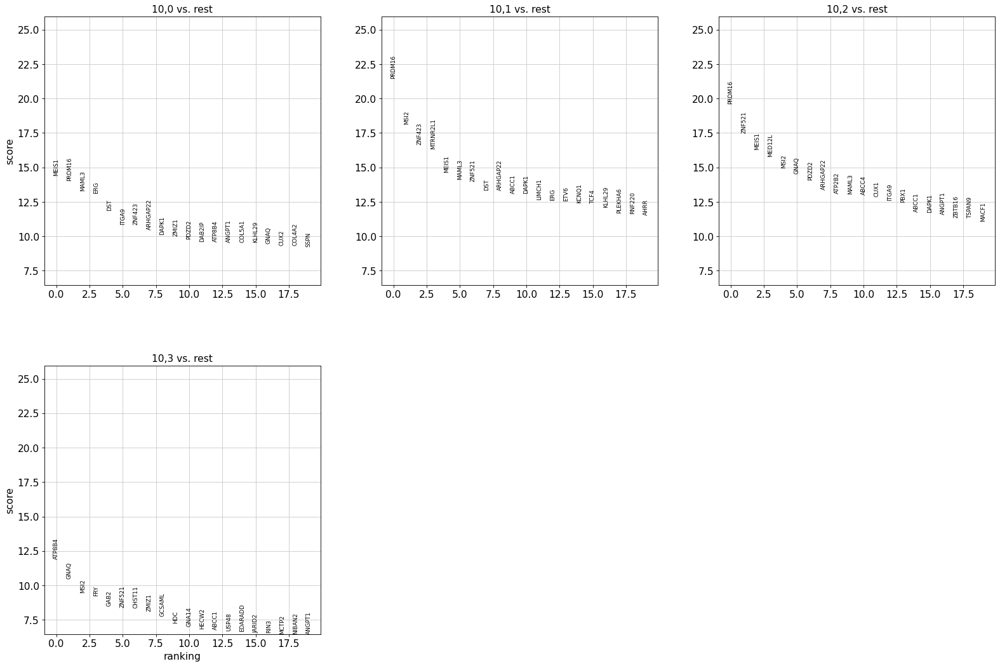

In [188]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 4

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

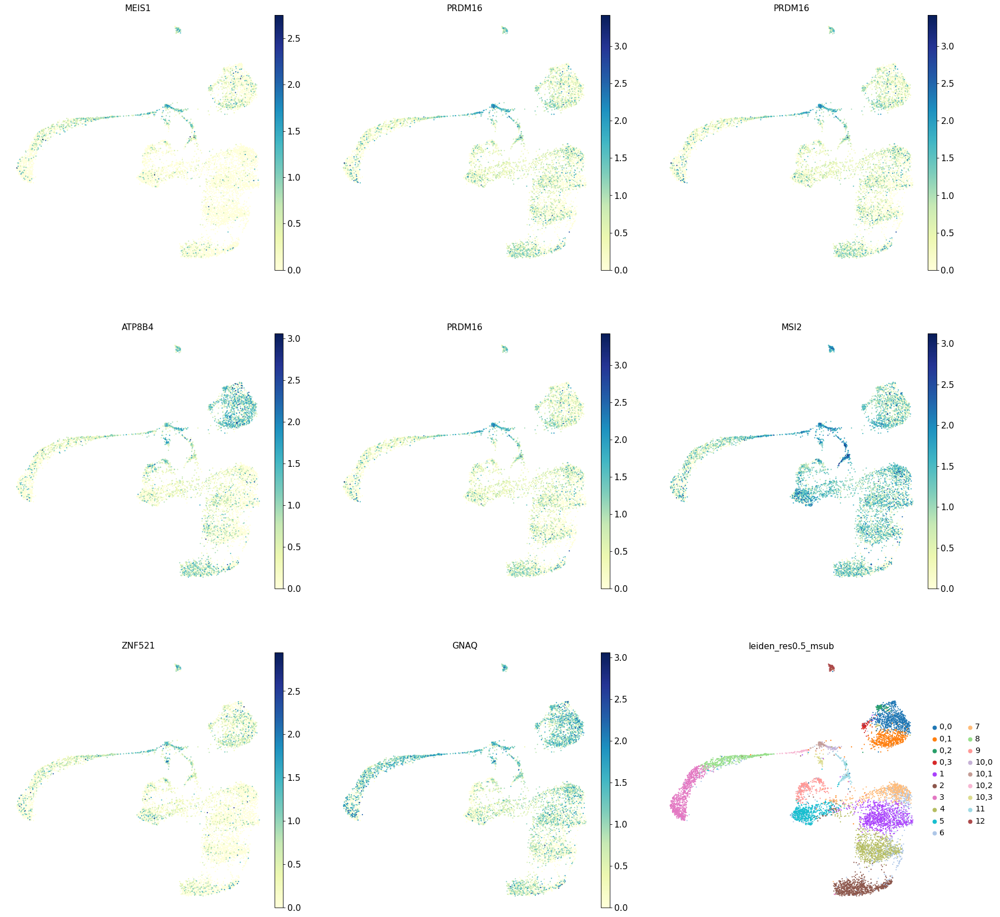

In [189]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

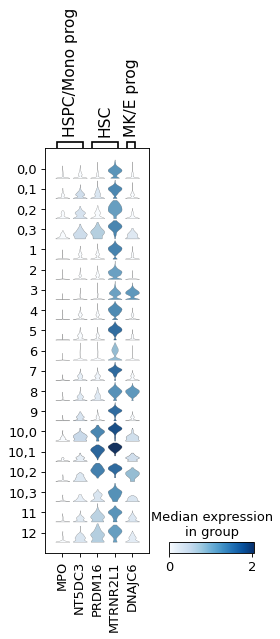

In [195]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['HSPC/Mono prog', 'HSC', 'MK/E prog']}, groupby=new_key)

#### Conclusion
- 10,0: HSPC/Mono prog
- 10,1: HSC
- 10,2: MK/E prog
- 10,3: Not sure


## pCDs - cluster 12

In [196]:
c_id = 12

In [197]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD 16+ Mono', 'ID2-hi myeloid prog', 'Naive CD20+ B', 'pDCs']

In [198]:
# Once the resolution looks good change new_key to leiden_sub
orig_key = 'leiden_res0.5_msub'
#new_key = 'leiden_temp'
new_key = 'leiden_res0.5_msub2'
new_rg_key = 'rg_msub2'
sub_key = str(c_id)


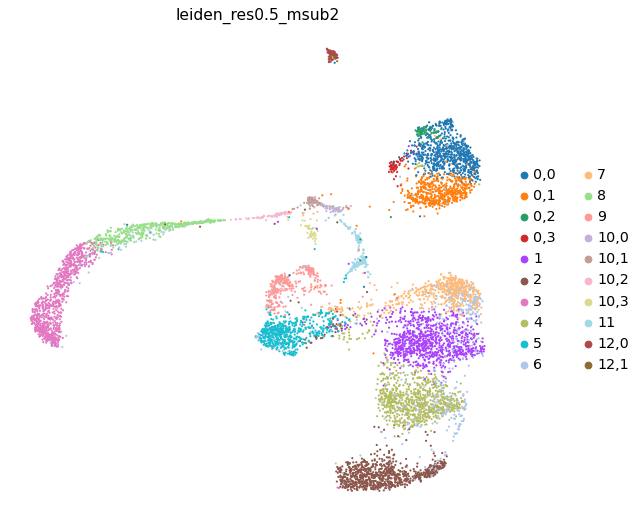

1       924
2       889
3       859
4       824
0,0     731
5       607
6       604
7       550
0,1     539
8       453
9       329
11      181
12,0     90
10,0     75
0,2      73
10,1     71
10,2     61
0,3      59
10,3     51
12,1     15
Name: leiden_res0.5_msub2, dtype: int64

In [199]:
res=0.2
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_atac, color=new_key)#, legend_loc='on data')
adata_atac.obs[new_key].value_counts()


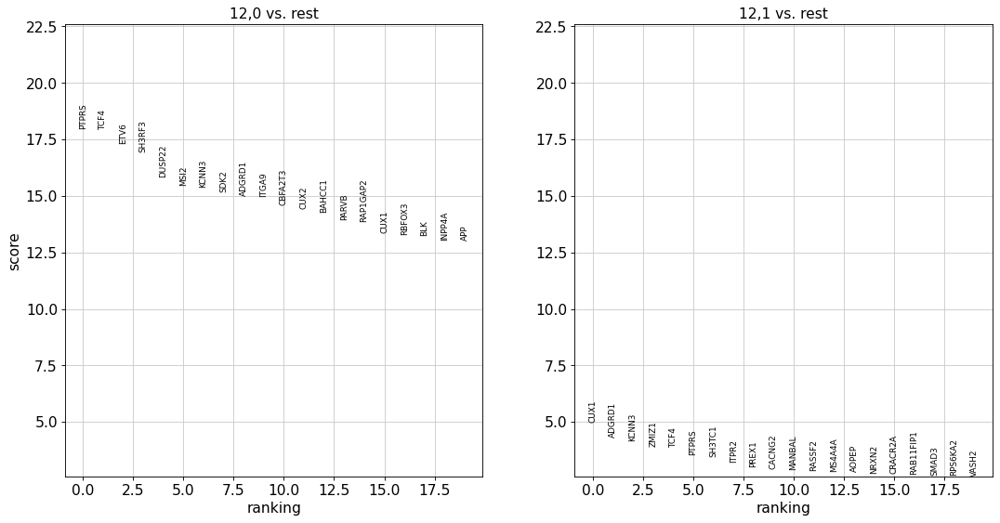

In [200]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

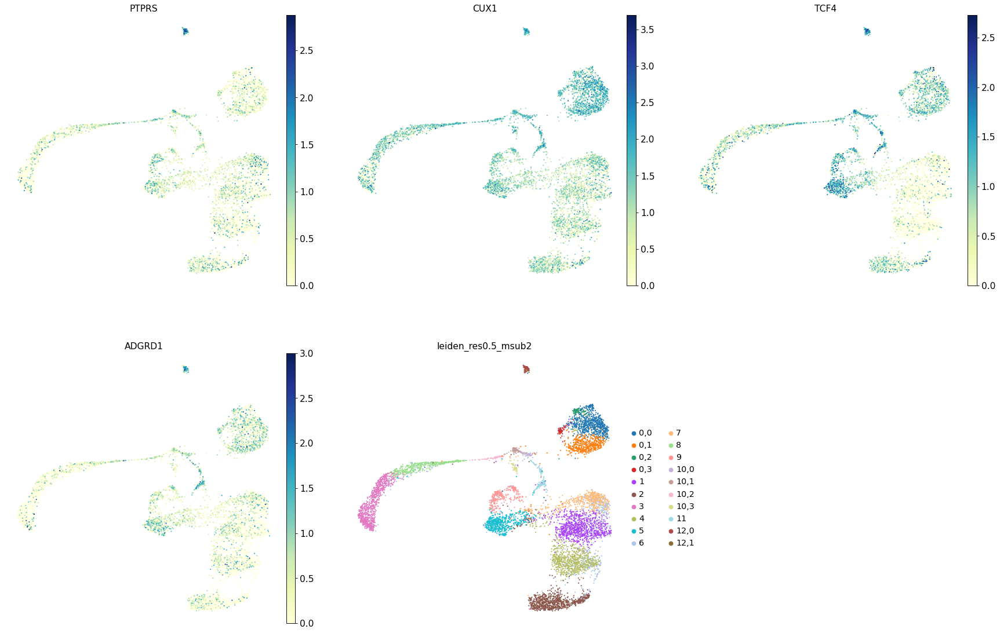

In [201]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

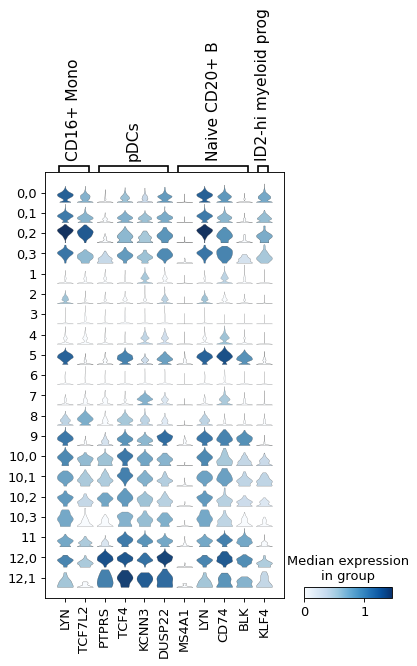

In [203]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['CD16+ Mono', 'pDCs', 'Naive CD20+ B', 'ID2-hi myeloid prog']}, groupby=new_key)

#### Conclusion

12,0 and 12,1 are very similar, and both show higher expression levels of pDCs compared to other clusters.

- 12: pDCs

## T cells

Clusters 1, 4, 7 have CD4 + T cell population. (Note. We will ignore the cluster 6 for now, as it does not have strong signal for any of the cell identities).

In [205]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'HSPC/Mono prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

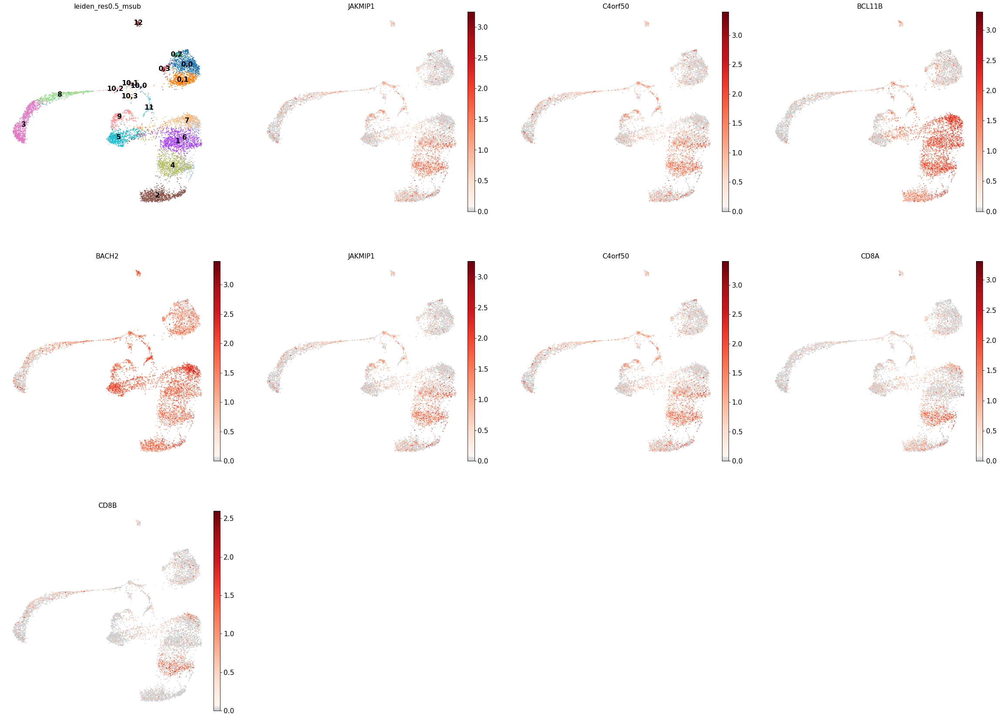

In [204]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_res0.5_msub']+
              marker_genes['CD4+ T activated']+
              marker_genes['CD4+ T naive']+
              marker_genes['CD8+ T']
          )

### cluster 1

In [224]:
c_id = 1

In [225]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD4+ T']

In [226]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_res0.5_msub'
#new_key = 'leiden_temp'
new_key = 'leiden_res0.5_tsub1'
new_rg_key = 'rg_tsub1'
sub_key = str(c_id)

In [232]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

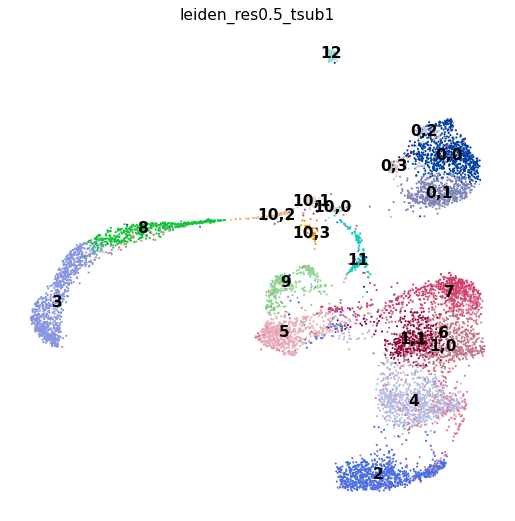

2       889
3       859
4       824
0,0     731
5       607
6       604
7       550
1,0     546
0,1     539
8       453
1,1     378
9       329
11      181
12      105
10,0     75
0,2      73
10,1     71
10,2     61
0,3      59
10,3     51
Name: leiden_res0.5_tsub1, dtype: int64

In [233]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

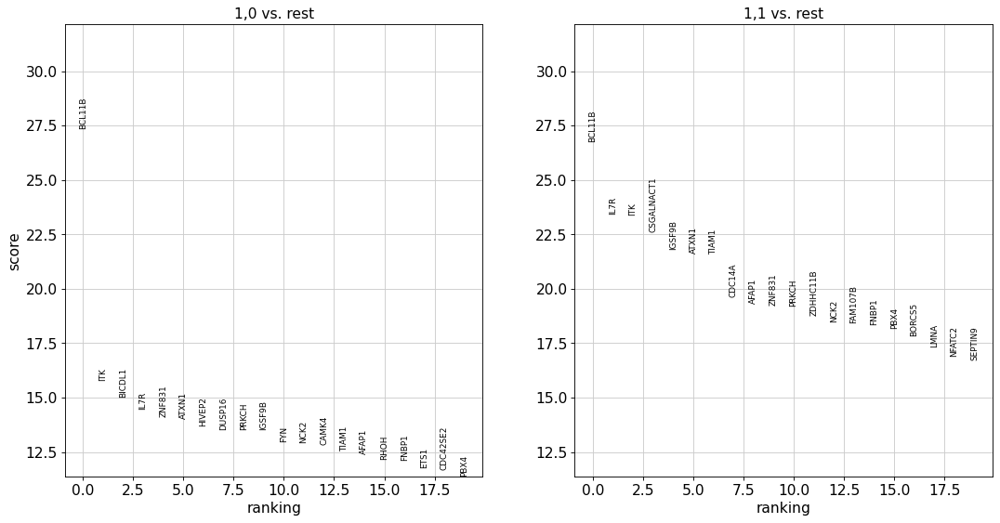

In [234]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

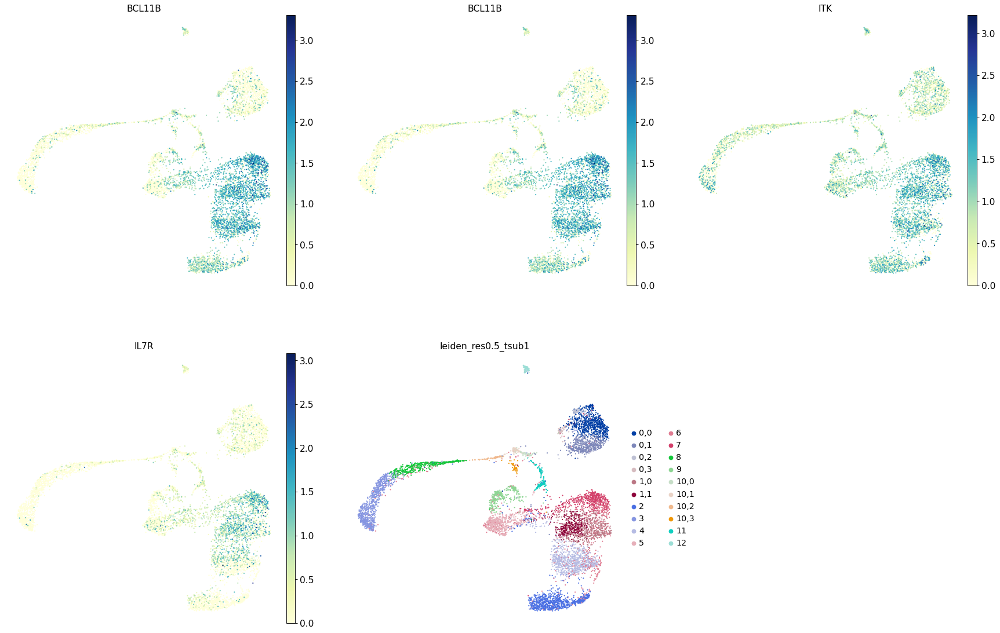

In [235]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

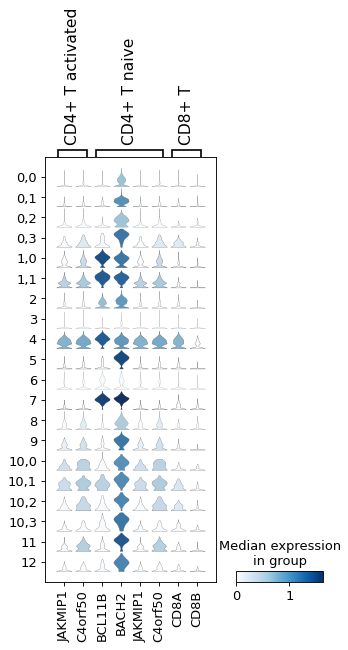

In [236]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['CD4+ T activated', 'CD4+ T naive', 'CD8+ T']}, groupby=new_key)

#### Conclusion

- 1,0: CD4+ T activated
- 1,1: CD4+ T activated

This is because there are some expresions for negative marker genes, such as JAKMIP1 and C4orf50.

Also, 1,0 and 1,1 look very similar, thus we will not sub-cluster this cluster 1, instead we will just define the cluster 1 as "CD4+ T activated".
- 1: CD4+ T activated


### cluster 4

From the UMAP above, the cluster 4 does not seem to have a clear sub-structure.
Still, let's see if there's a sub-structure that we could sub-cluster further.

In [245]:
c_id = 4

In [246]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD4+ T', 'CD8+ T']

In [247]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_res0.5_msub'
#new_key = 'leiden_temp'
new_key = 'leiden_res0.5_tsub2'
new_rg_key = 'rg_tsub2'
sub_key = str(c_id)

In [248]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

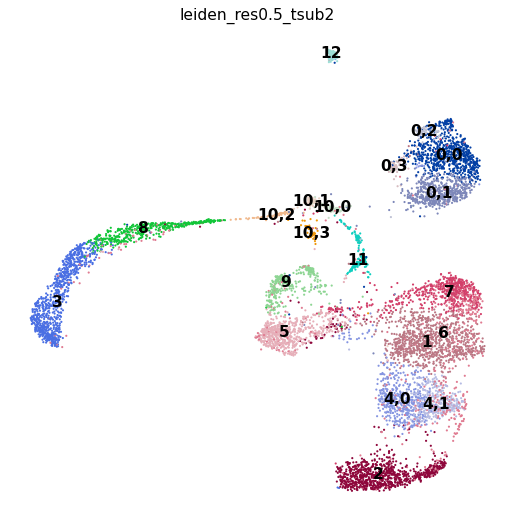

1       924
2       889
3       859
0,0     731
5       607
6       604
7       550
0,1     539
4,0     504
8       453
9       329
4,1     320
11      181
12      105
10,0     75
0,2      73
10,1     71
10,2     61
0,3      59
10,3     51
Name: leiden_res0.5_tsub2, dtype: int64

In [249]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

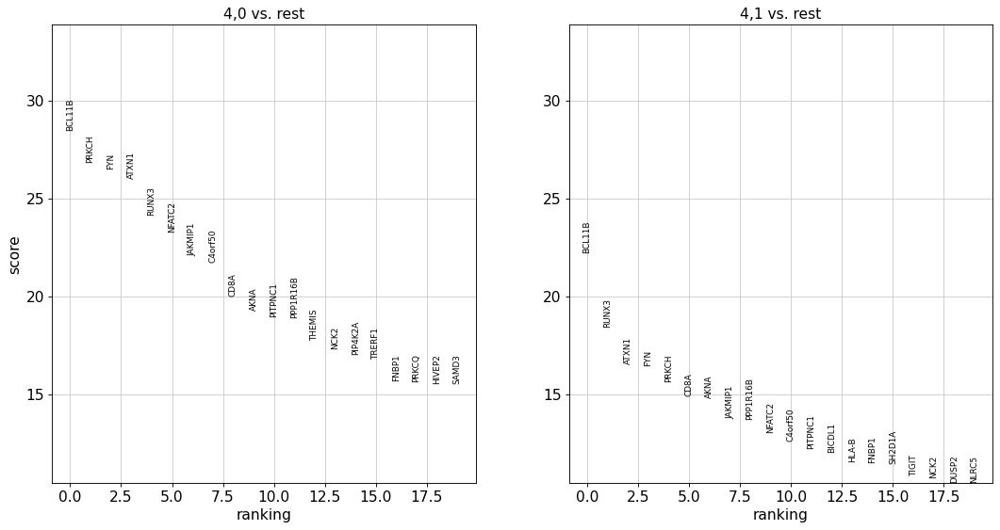

In [250]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

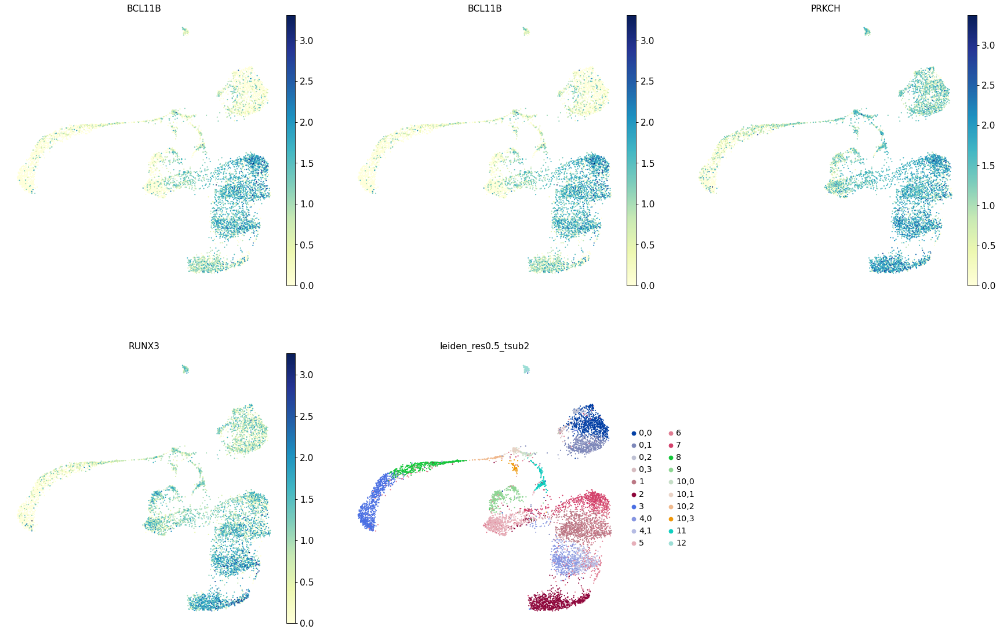

In [251]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

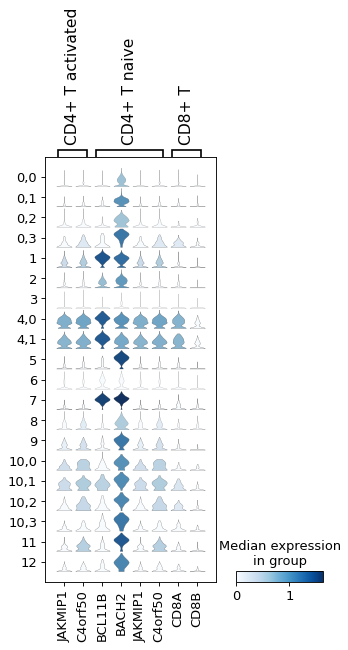

In [252]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['CD4+ T activated', 'CD4+ T naive', 'CD8+ T']}, groupby=new_key)

#### Conclusion
Indeed, the sub-clusters 4,0 and 4,1 are indistinguishable.

The cluster 4 is CD4+ T activated, CD8+ T

### cluster 7

In [253]:
c_id = 7

In [254]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD4 + T', 'HSC']

In [255]:
# Once the resolution looks good change new_key to leiden final

# Let's reuse the ID after the sub-clustering the cluster 1, as we are not sub-clustering the cluster 4, as described above.
orig_key = 'leiden_res0.5_msub'
#new_key = 'leiden_temp'
new_key = 'leiden_res0.5_tsub2'
new_rg_key = 'rg_tsub2'
sub_key = str(c_id)

In [256]:
res=0.2
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

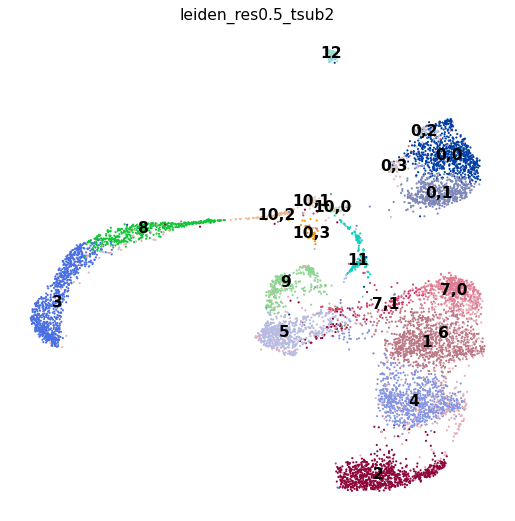

1       924
2       889
3       859
4       824
0,0     731
5       607
6       604
0,1     539
8       453
7,0     442
9       329
11      181
7,1     108
12      105
10,0     75
0,2      73
10,1     71
10,2     61
0,3      59
10,3     51
Name: leiden_res0.5_tsub2, dtype: int64

In [257]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

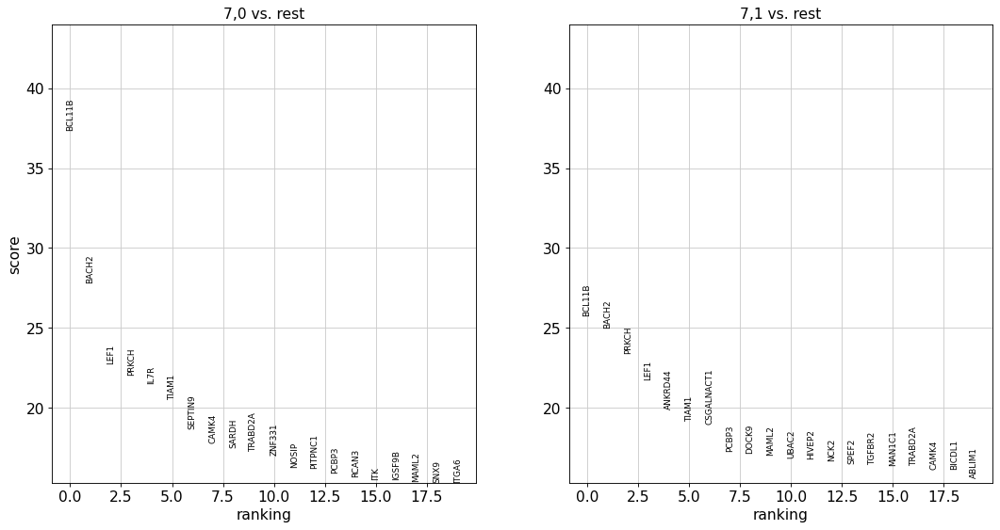

In [258]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

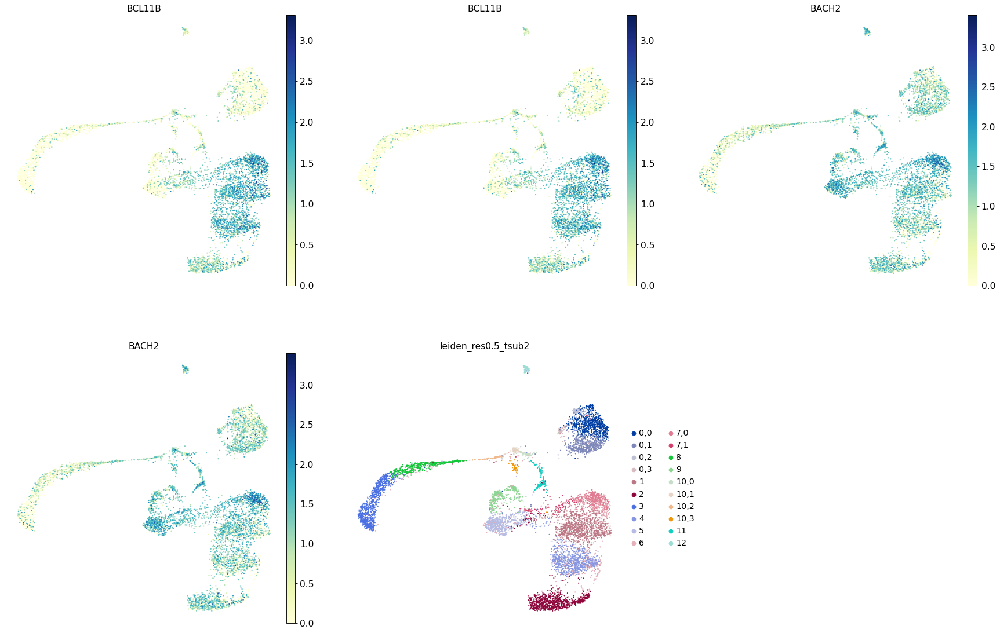

In [259]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

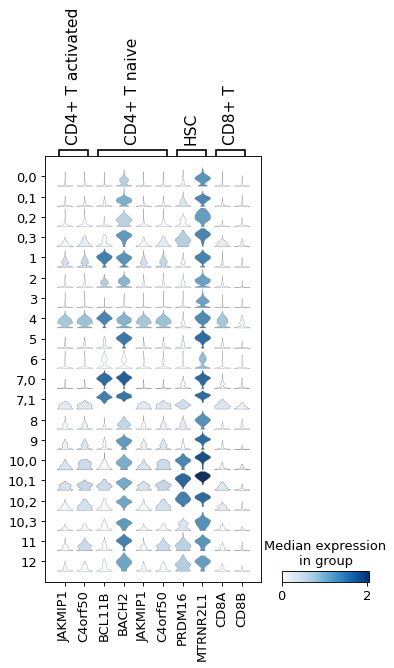

In [260]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['CD4+ T activated', 'CD4+ T naive', 'HSC','CD8+ T']}, groupby=new_key)

#### Conclusion
- 7,0: CD4+ T naive
- 7,1: CD4+ T naive

We will NOT sub-cluster the cluster 7 as its sub-clusters look more or less identical to each other.

- 7: CD4+ T naive

## NK - ILC

In [261]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'HSPC/Mono prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

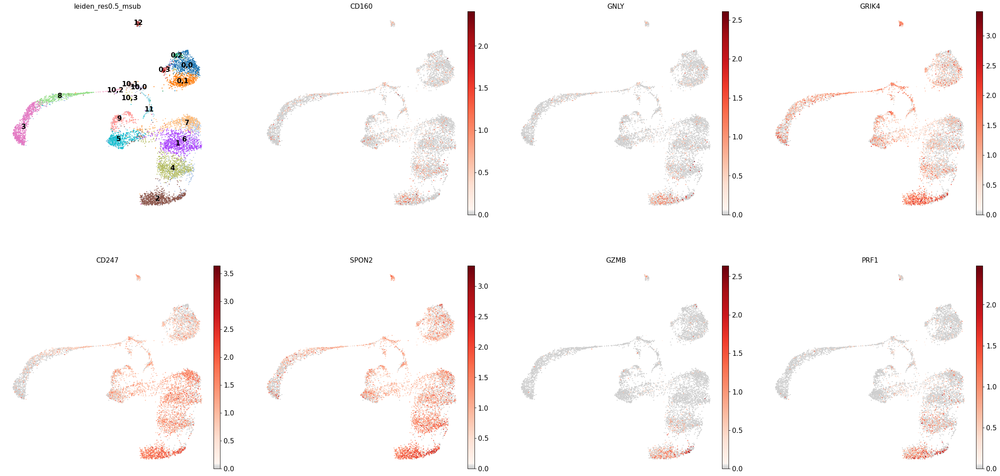

In [262]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_res0.5_msub']+
              marker_genes['NK']+
              marker_genes['ILC']
          )

### cluster 2

In [263]:
c_id = 2

In [264]:
# Initial assignment
init_clus_dict[str(c_id)]

['NK', 'ILC']

#### sub-clustering

In [265]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_res0.5_msub'
#new_key = 'leiden_temp'
new_key = 'leiden_res0.5_nsub'
new_rg_key = 'rg_nsub'
sub_key = str(c_id)

In [266]:
res=0.2
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

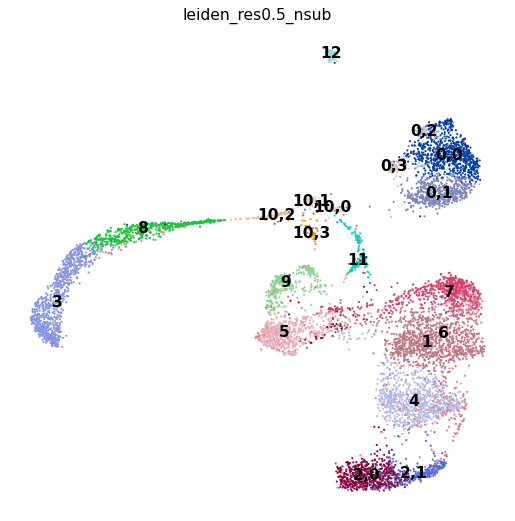

1       924
3       859
4       824
0,0     731
5       607
6       604
2,0     575
7       550
0,1     539
8       453
9       329
2,1     314
11      181
12      105
10,0     75
0,2      73
10,1     71
10,2     61
0,3      59
10,3     51
Name: leiden_res0.5_nsub, dtype: int64

In [267]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

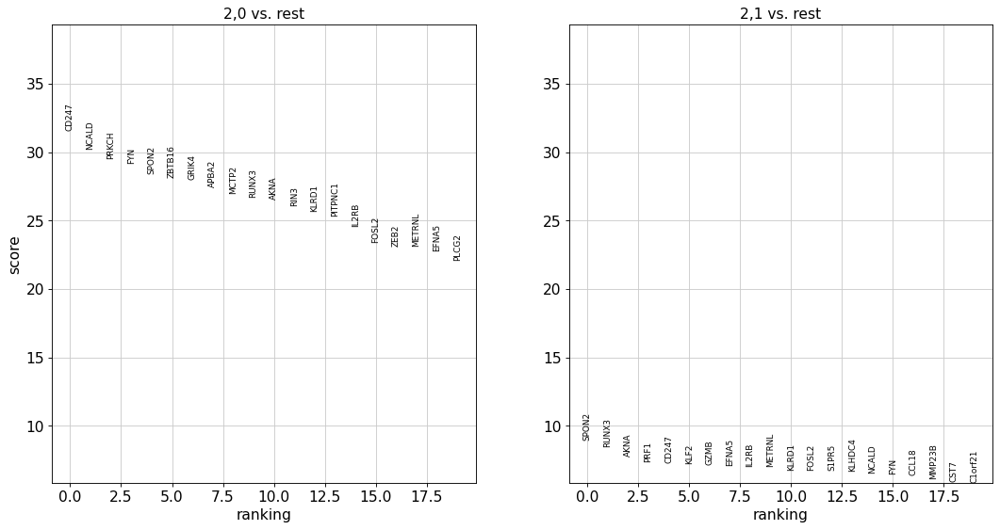

In [268]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

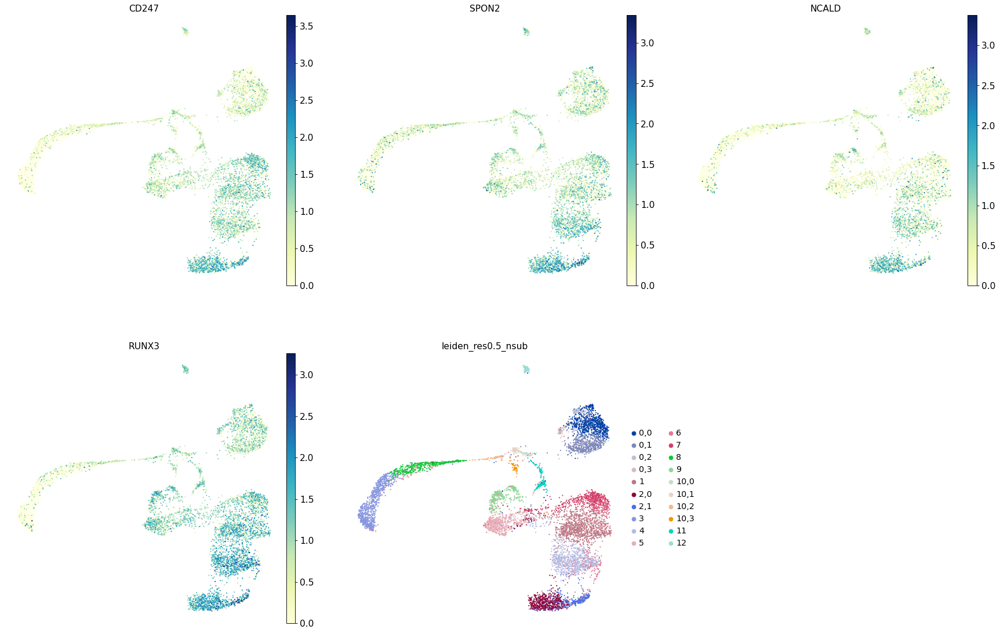

In [269]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

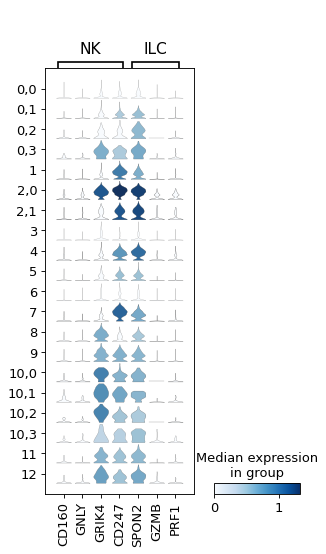

In [270]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['NK','ILC']}, groupby=new_key)

#### Conclusion
- 2,0: NK
- 2,1: ILC

## Proerythroblast - Erythroblast - Reticulocyte (clusters 3 and 8)

In [271]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'HSPC/Mono prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

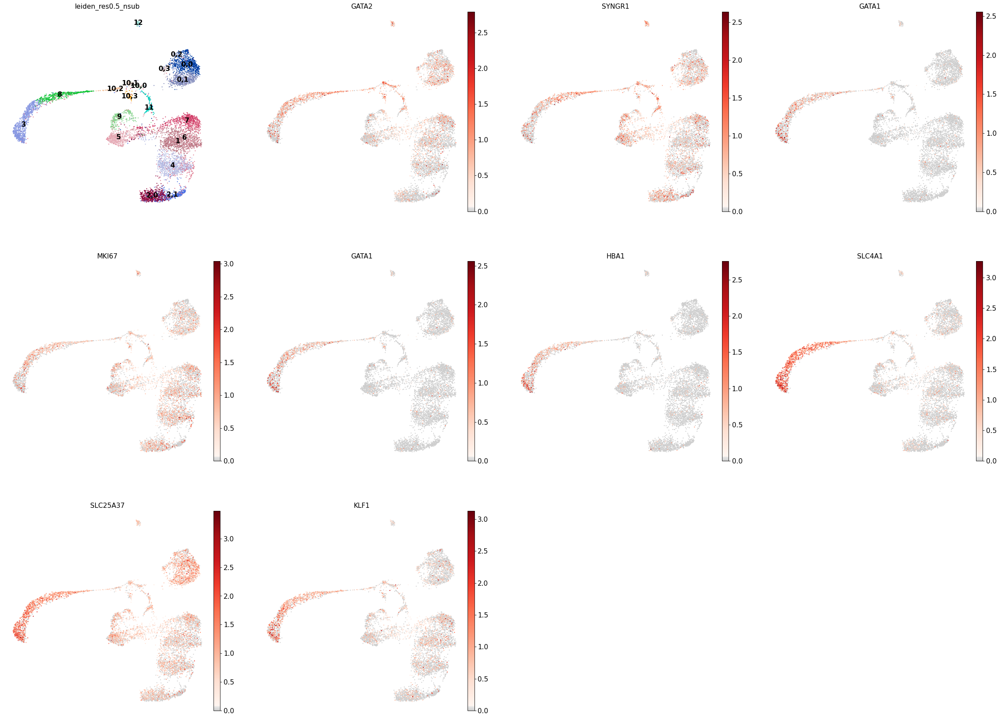

In [272]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_res0.5_nsub']+
           marker_genes['Proerythroblast']+
           marker_genes['Erythroblast']+
           marker_genes['Reticulocyte']
          )

### cluster 3

In [273]:
c_id = 3

In [274]:
# Initial assignment
init_clus_dict[str(c_id)]

['Reticulocyte', 'MK/E prog']

In [275]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_res0.5_nsub'
#new_key = 'leiden_temp'
new_key = 'leiden_res0.5_esub'
new_rg_key = 'rg_esub'
sub_key = str(c_id)

In [286]:
res=0.2
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

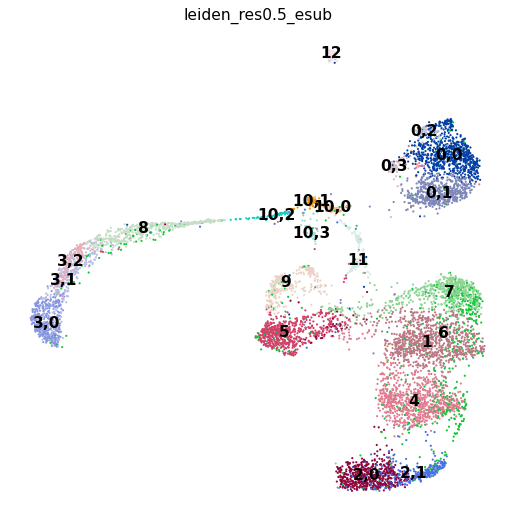

1       924
4       824
0,0     731
5       607
6       604
2,0     575
7       550
0,1     539
8       453
3,0     385
9       329
2,1     314
3,1     291
3,2     183
11      181
12      105
10,0     75
0,2      73
10,1     71
10,2     61
0,3      59
10,3     51
Name: leiden_res0.5_esub, dtype: int64

In [287]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

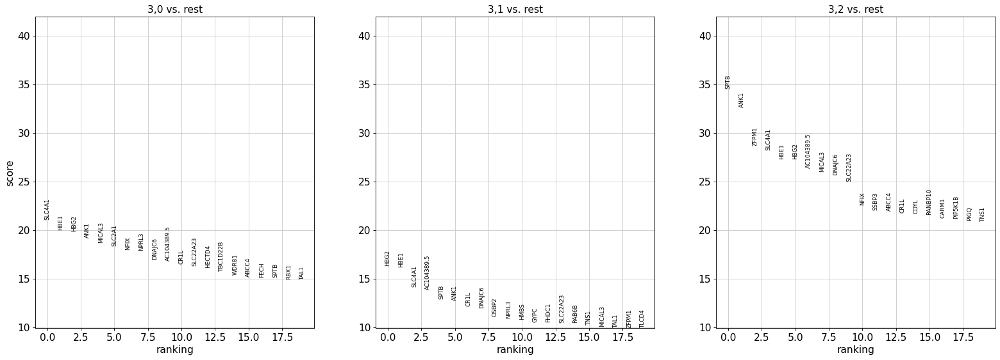

In [288]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 3

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

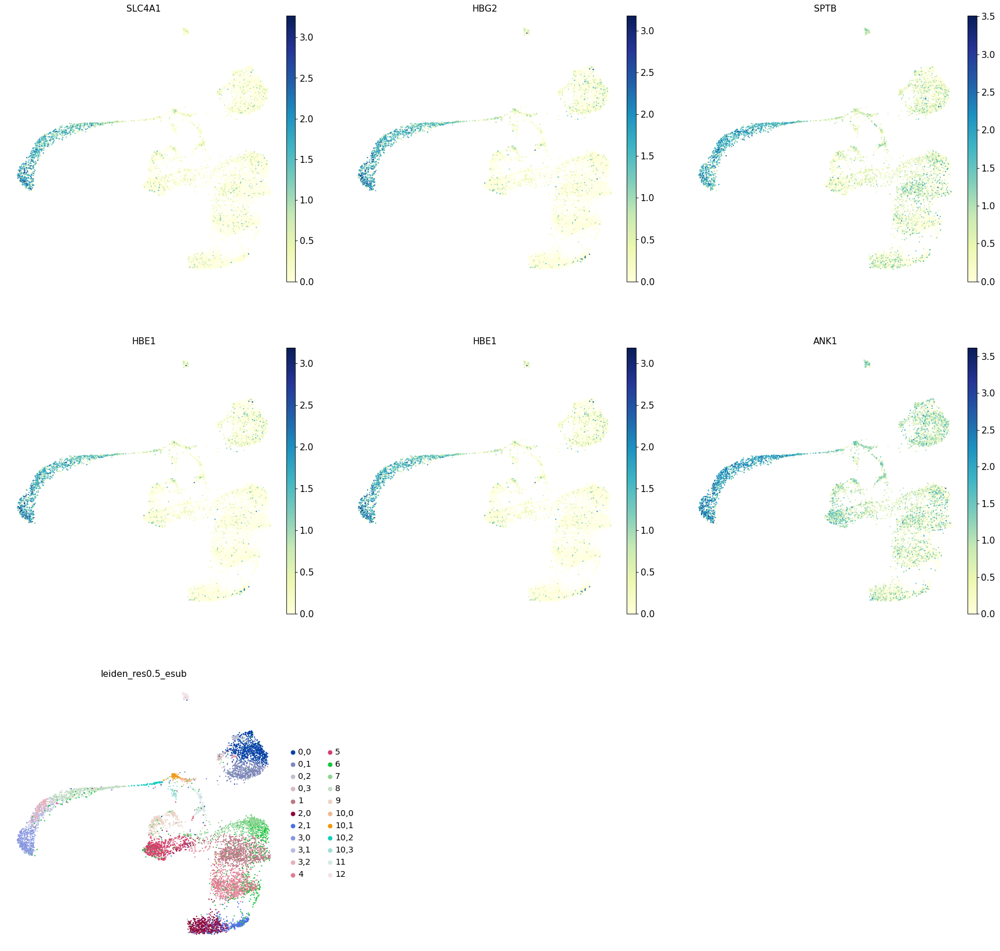

In [289]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

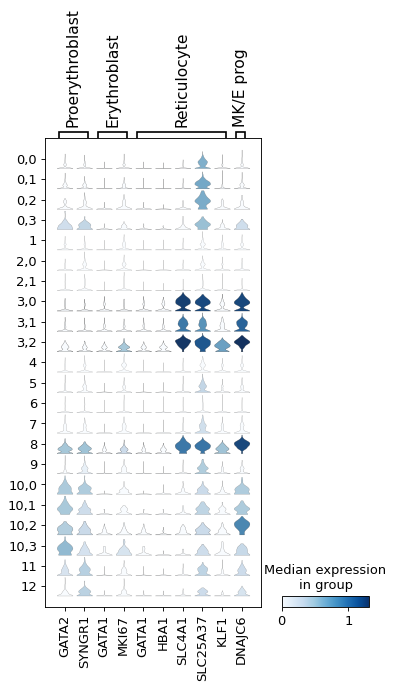

In [290]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['Proerythroblast','Erythroblast','Reticulocyte','MK/E prog']}, groupby=new_key)

#### Conclusion

- 3,0: Reticulocyte
- 3,1: Reticulocyte
- 3,2: Reticulocyte, Erythroblast

### cluster 8

In [291]:
c_id = 8

In [292]:
# Initial assignment
init_clus_dict[str(c_id)]

['Proerythroblast', 'Reticulocyte']

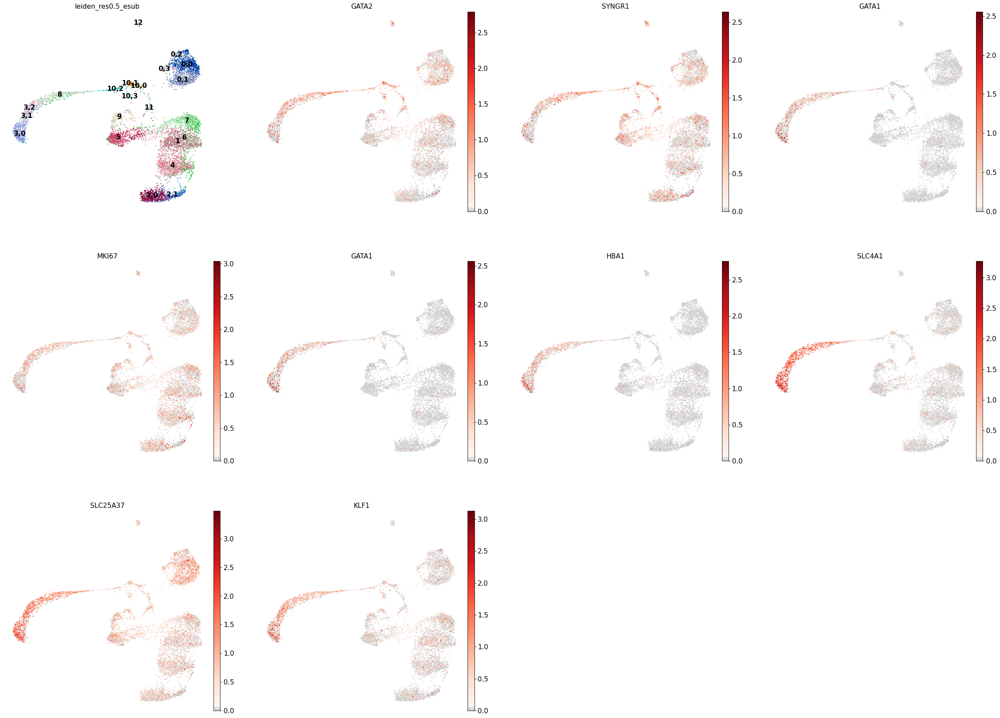

In [293]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_res0.5_esub']+
           marker_genes['Proerythroblast']+
           marker_genes['Erythroblast']+
           marker_genes['Reticulocyte']
          )

In [294]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_res0.5_esub'
#new_key = 'leiden_temp'
new_key = 'leiden_res0.5_esub2'
new_rg_key = 'rg_esub2'
sub_key = str(c_id)

In [295]:
res=0.15
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

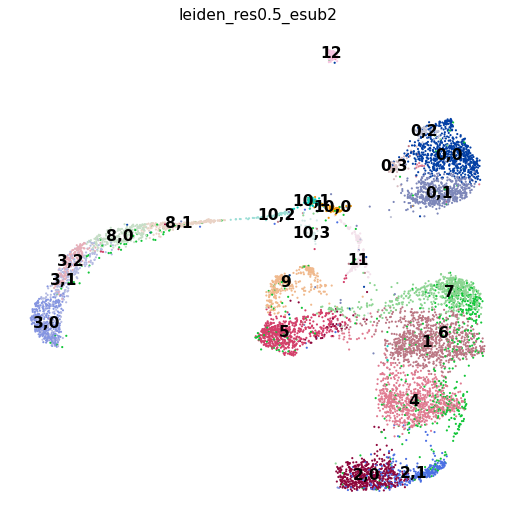

1       924
4       824
0,0     731
5       607
6       604
2,0     575
7       550
0,1     539
3,0     385
9       329
2,1     314
3,1     291
8,0     244
8,1     209
3,2     183
11      181
12      105
10,0     75
0,2      73
10,1     71
10,2     61
0,3      59
10,3     51
Name: leiden_res0.5_esub2, dtype: int64

In [296]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

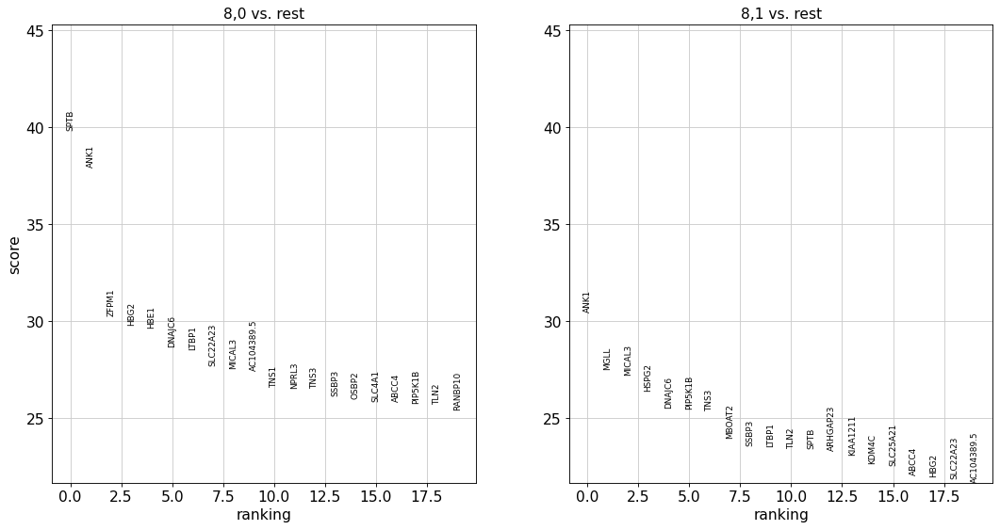

In [297]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

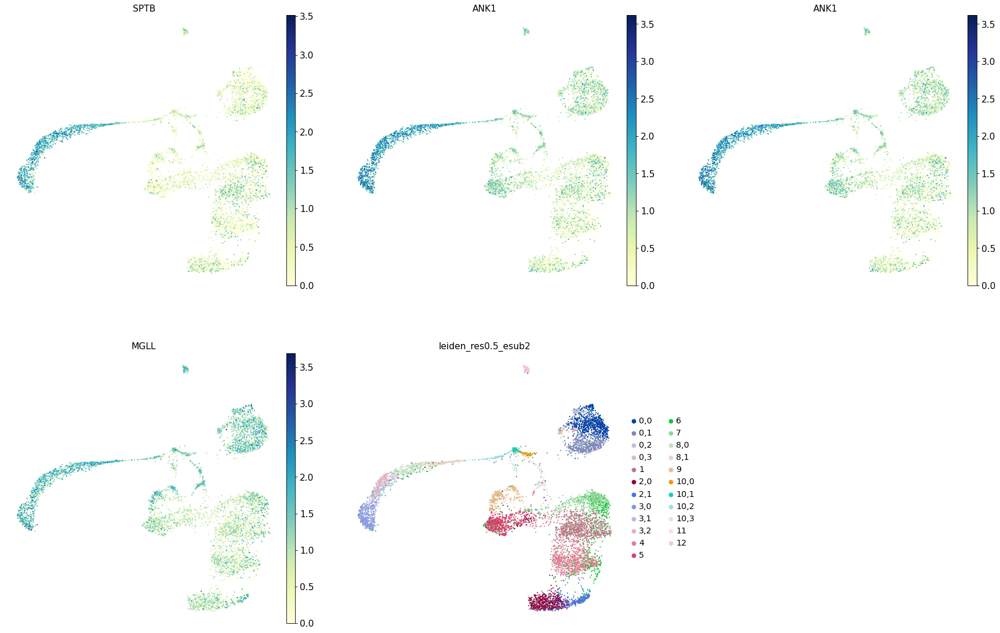

In [298]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

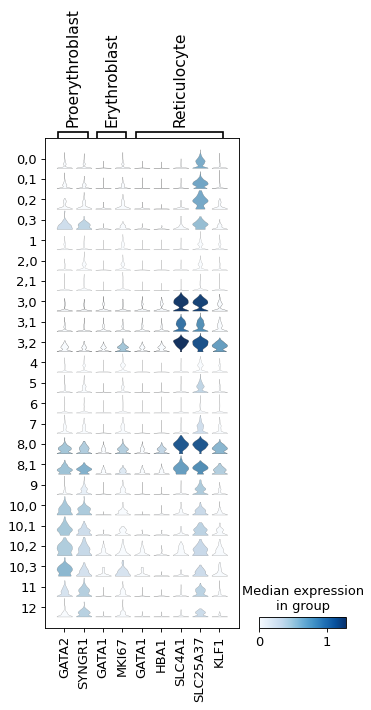

In [299]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['Proerythroblast','Erythroblast','Reticulocyte']}, groupby=new_key)

#### Conclusion
- 8,0: Proerythroblast, Erythroblast
- 8,1: Proerythroblast, Erythroblast

As we have not seen a clear sub-structure in the cluster 8, we will not sub-cluster it.

## B cells - Plasma (clusters 5, 9, and 11)

In [300]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'HSPC/Mono prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

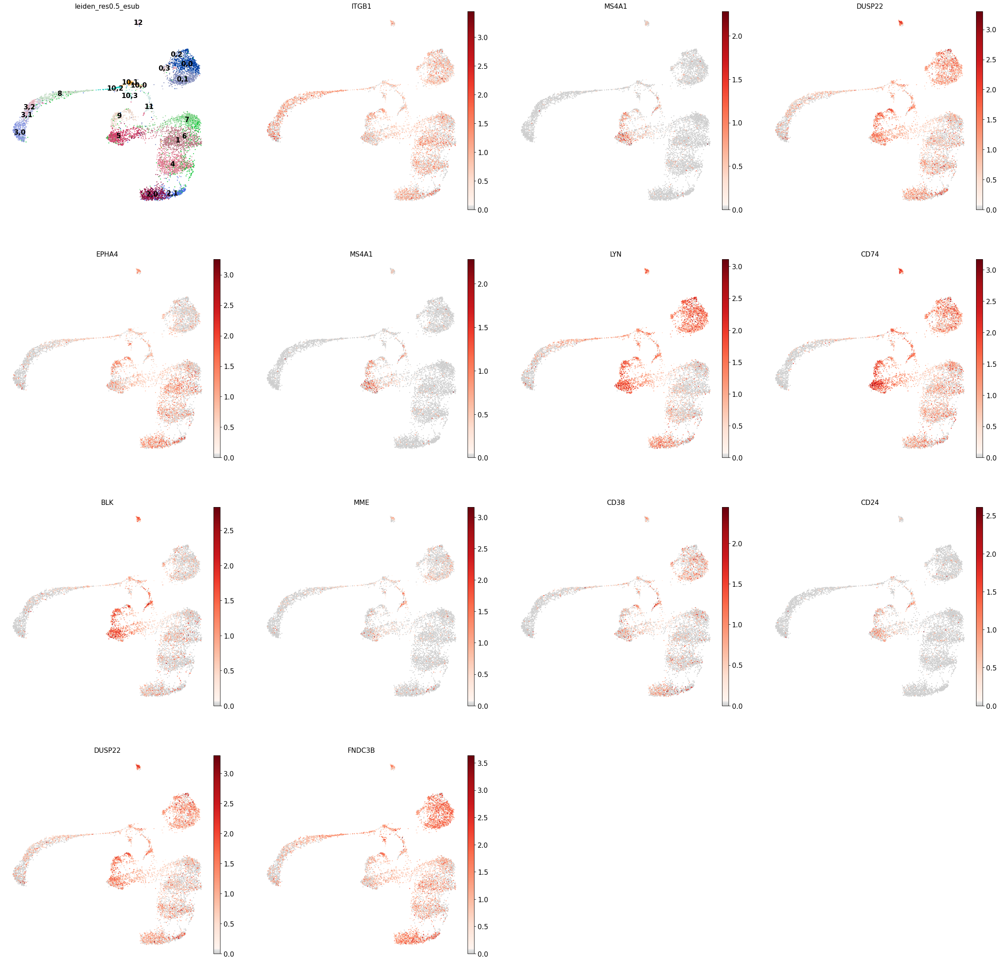

In [301]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_res0.5_esub']+
           marker_genes['B1 B']+
           marker_genes['Naive CD20+ B']+
           marker_genes['Transitional B']+
           marker_genes['Plasma cells']
          )

### cluster 5

In [302]:
c_id = 5

In [303]:
# Initial assignment
init_clus_dict[str(c_id)]

['Naive CD20+ B']

### cluster 9

In [304]:
c_id = 9

In [305]:
# Initial assignment
init_clus_dict[str(c_id)]

['Naive CD20+ B', 'B1 B']

#### Split substructure

In [306]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_res0.5_esub'
#new_key = 'leiden_temp'
new_key = 'leiden_res0.5_bsub1'
new_rg_key = 'rg_bsub1'
sub_key = str(c_id)

In [315]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

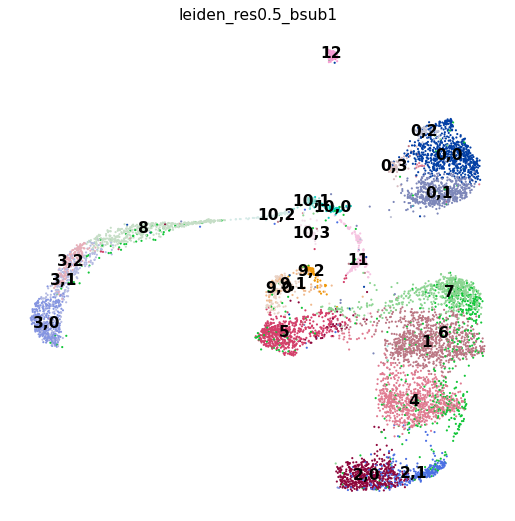

1       924
4       824
0,0     731
5       607
6       604
2,0     575
7       550
0,1     539
8       453
3,0     385
2,1     314
3,1     291
3,2     183
11      181
9,0     162
12      105
9,1      89
9,2      78
10,0     75
0,2      73
10,1     71
10,2     61
0,3      59
10,3     51
Name: leiden_res0.5_bsub1, dtype: int64

In [316]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

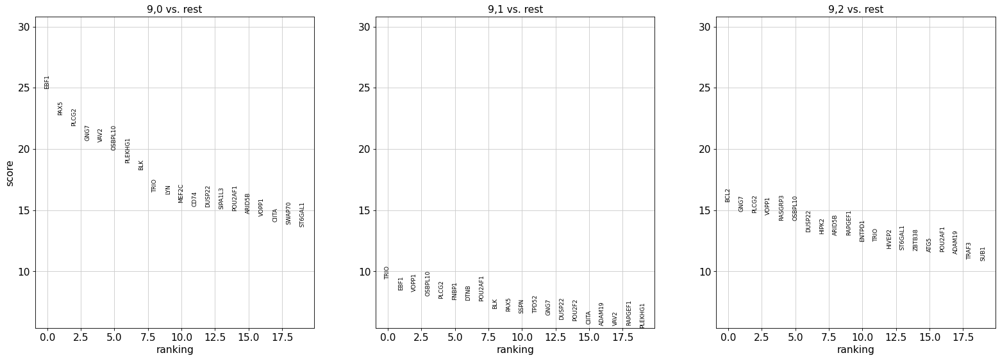

In [317]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 3

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

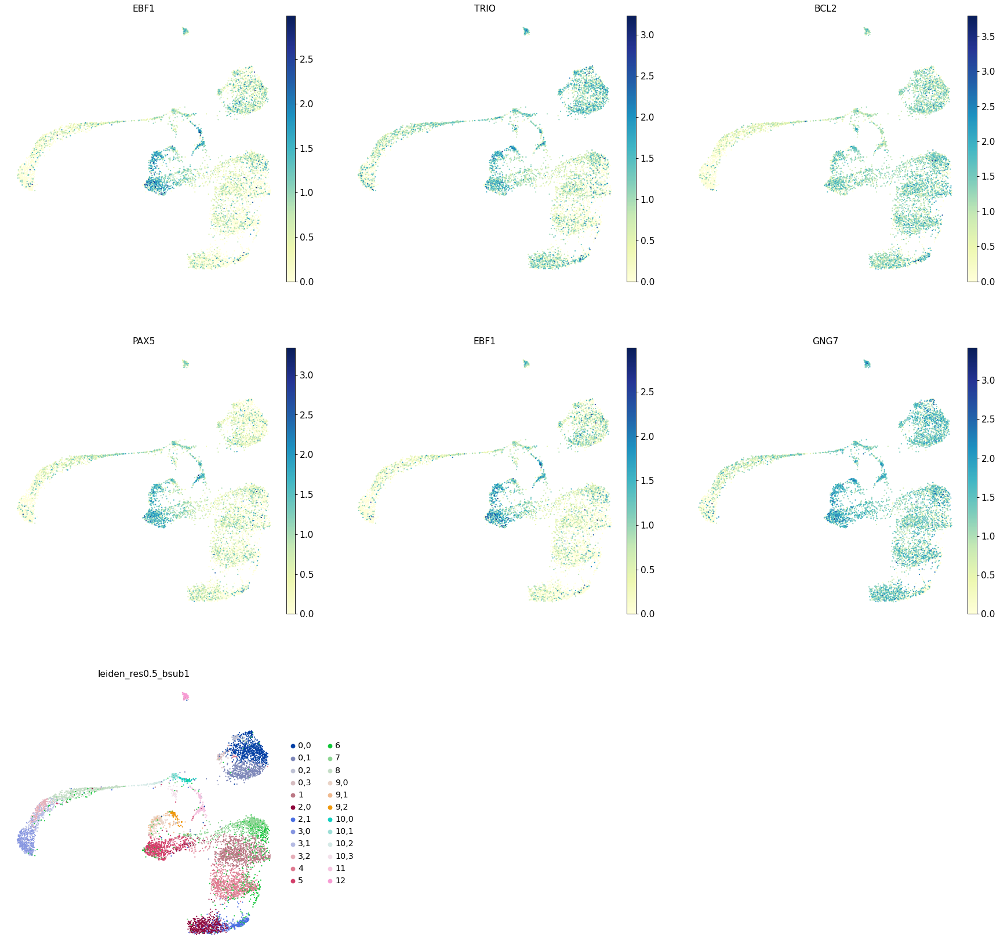

In [318]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

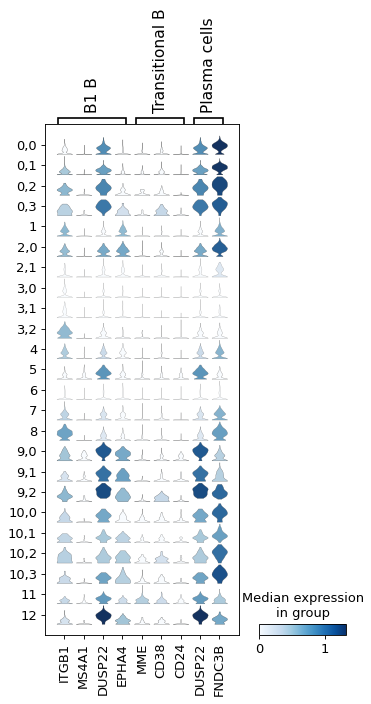

In [319]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in [ 'B1 B', 'Transitional B', 'Plasma cells']}, groupby=new_key)

#### Conclusion

- 9,0: B1 B
- 9,1: B1 B
- 9,2: Plasma cells

### cluster 11

In [320]:
c_id = 11

In [321]:
# Initial assignment
init_clus_dict[str(c_id)]

['Naive CD20+ B', 'Transitional BpDCs']

#### Split substructure

In [322]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_res0.5_bsub1'
#new_key = 'leiden_temp'
new_key = 'leiden_res0.5_bsub2'
new_rg_key = 'rg_bsub2'
sub_key = str(c_id)

In [323]:
res=0.1
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

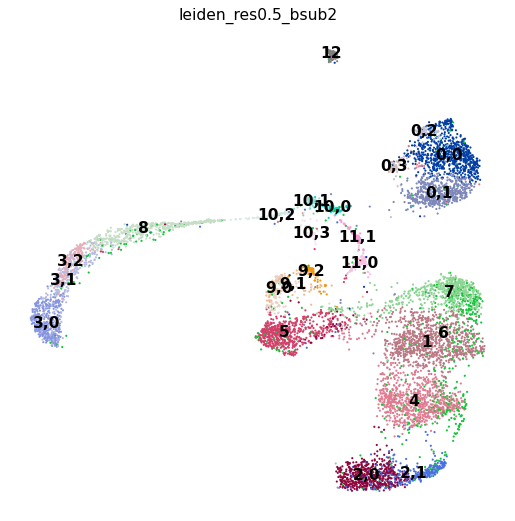

1       924
4       824
0,0     731
5       607
6       604
2,0     575
7       550
0,1     539
8       453
3,0     385
2,1     314
3,1     291
3,2     183
9,0     162
11,0    119
12      105
9,1      89
9,2      78
10,0     75
0,2      73
10,1     71
11,1     62
10,2     61
0,3      59
10,3     51
Name: leiden_res0.5_bsub2, dtype: int64

In [324]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

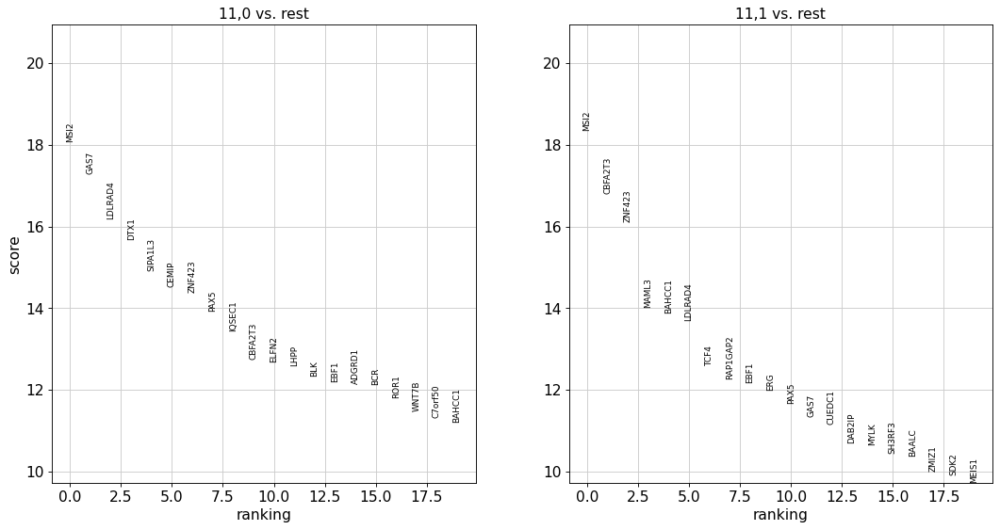

In [325]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 2

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

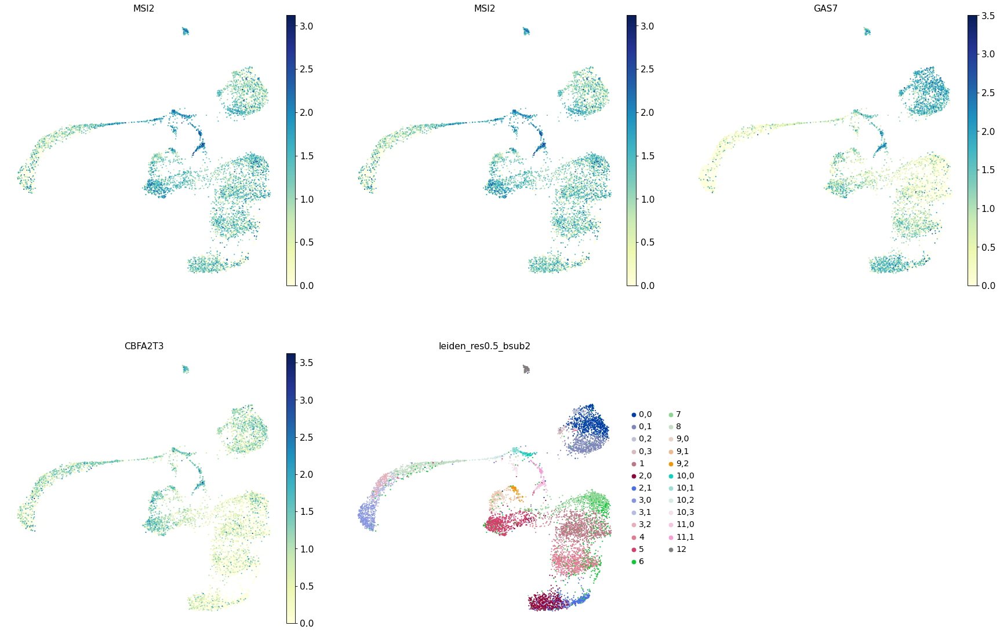

In [326]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3)

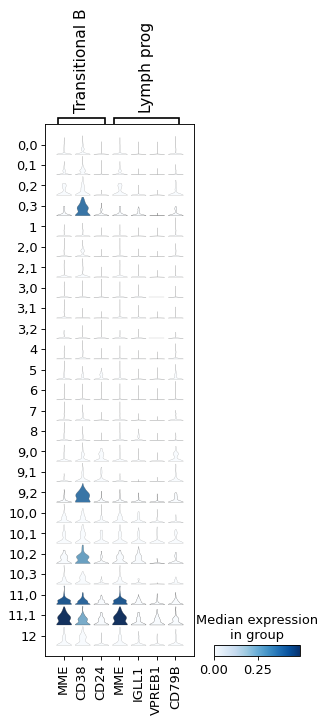

In [328]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in [ 'Transitional B', 'Lymph prog']}, groupby=new_key)

#### Conclusion

- 11,0: Transitional B
- 11,1: Lymph prog.

## Cluster 6

Cluster 6 showed no strong expression of any marker genes. We dissect this cluster a little further.

In [329]:
marker_genes

{'CD14+ Mono': ['TREM1', 'FPR1'],
 'CD16+ Mono': ['LYN', 'TCF7L2'],
 'ID2-hi myeloid prog': ['KLF4'],
 'cDC2': ['TREM1', 'DMXL2'],
 'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
 'Erythroblast': ['GATA1', 'MKI67'],
 'Proerythroblast': ['GATA2', 'SYNGR1'],
 'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
 'ILC': ['SPON2', 'GZMB', 'PRF1'],
 'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
 'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
 'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
 'Transitional B': ['MME', 'CD38', 'CD24'],
 'Plasma cells': ['DUSP22', 'FNDC3B'],
 'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
 'CD4+ T naive': ['BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'],
 'CD8+ T': ['CD8A', 'CD8B'],
 'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
 'HSPC/Mono prog': ['MPO', 'NT5DC3'],
 'HSC': ['PRDM16', 'MTRNR2L1'],
 'MK/E prog': ['DNAJC6']}

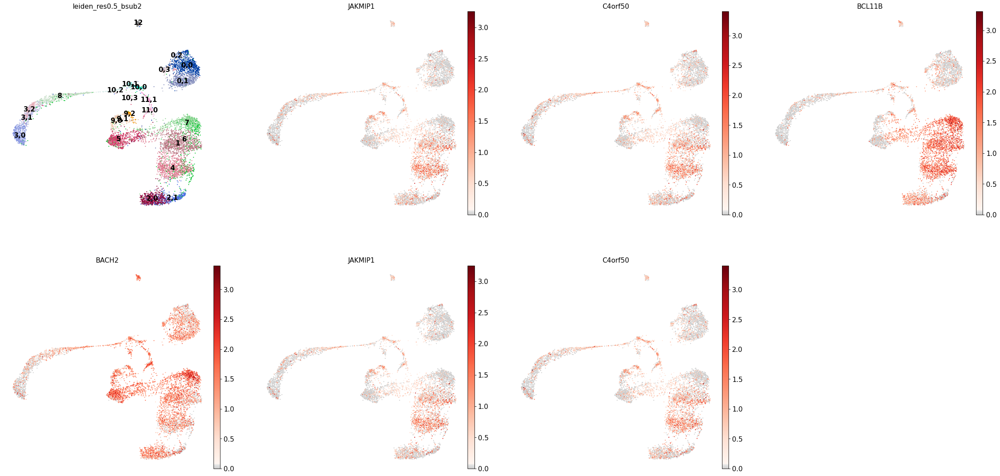

In [330]:
# Replot clusters and marker genes
sc.pl.umap(adata_atac, cmap=mymap, legend_loc = 'on data',
           color = ['leiden_res0.5_bsub2']+
              marker_genes['CD4+ T activated']+
              marker_genes['CD4+ T naive']
          ) 

### cluster 6

In [331]:
c_id = 6

In [332]:
# Initial assignment
init_clus_dict[str(c_id)]

['CD4 + T']

#### Split substructure

In [333]:
# Once the resolution looks good change new_key to leiden final
orig_key = 'leiden_res0.5_bsub2'
#new_key = 'leiden_temp'
new_key = 'leiden_dsub'
new_rg_key = 'rg_dsub'
sub_key = str(c_id)

In [334]:
res=0.3
sc.tl.leiden(adata_atac, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)

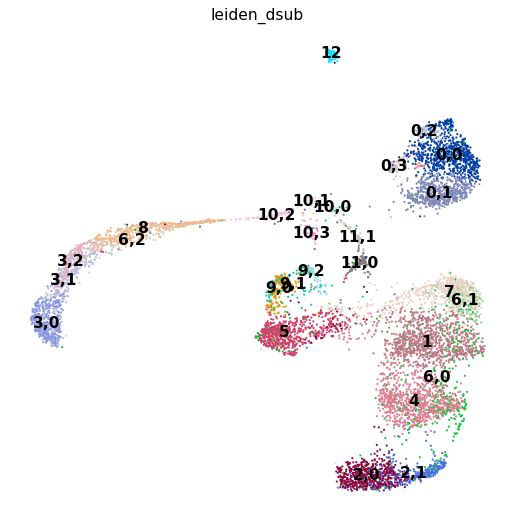

1       924
4       824
0,0     731
5       607
2,0     575
7       550
0,1     539
8       453
6,0     402
3,0     385
2,1     314
3,1     291
3,2     183
9,0     162
6,1     138
11,0    119
12      105
9,1      89
9,2      78
10,0     75
0,2      73
10,1     71
6,2      64
11,1     62
10,2     61
0,3      59
10,3     51
Name: leiden_dsub, dtype: int64

In [335]:
sc.pl.umap(adata_atac, color=new_key, legend_loc='on data')
adata_atac.obs[new_key].value_counts()

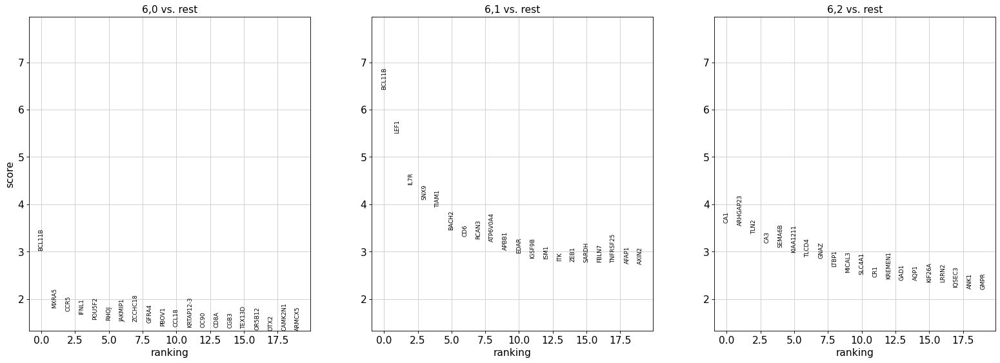

In [336]:
# Check markers of subclusters

#set number of clusters
num_subclusts = 3

new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_atac, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_atac, key=new_rg_key, groups=new_groups, ncols=3)

In [337]:
top_2_genes = list(adata_atac.uns[new_rg_key]['names'][0])+list(adata_atac.uns[new_rg_key]['names'][1])
top_2_genes

['BCL11B', 'BCL11B', 'CA1', 'MXRA5', 'LEF1', 'ARHGAP23']

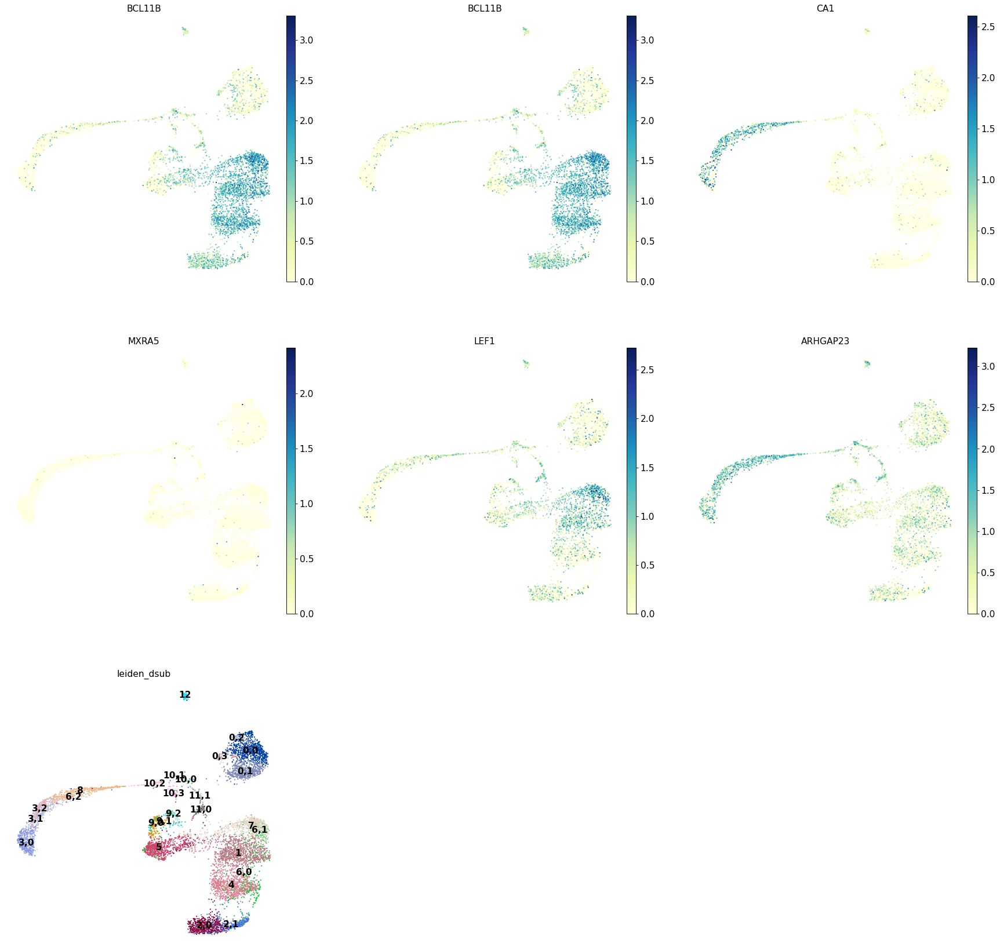

In [338]:
sc.pl.umap(adata_atac, color=top_2_genes+[new_key], ncols=3, legend_loc = 'on data')

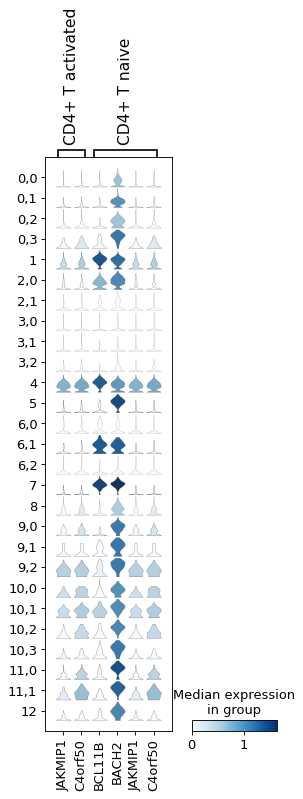

In [339]:
sc.pl.stacked_violin(adata_atac, var_names={a:marker_genes[a] for a in ['CD4+ T activated', 'CD4+ T naive']}, groupby=new_key)

#### Conclusion

- 6,0: low quality T cells
- 6,1: CD4+ T naive
- 6,2: low quality T cells

## Final annotation

In [132]:
init_clus_dict

{'0': ['CD 14+ Mono', 'CD 16+ Mono', 'cDC2', 'CD14+ Mono prog'],
 '1': ['CD4+ T'],
 '2': ['NK', 'ILC'],
 '3': ['Reticulocyte', 'MK/E prog'],
 '4': ['CD4+ T', 'CD8+ T'],
 '5': ['Naive CD20+ B'],
 '6': ['CD4 + T'],
 '7': ['CD4 + T', 'HSC'],
 '8': ['Proerythroblast', 'Reticulocyte'],
 '9': ['Naive CD20+ B', 'B1 B'],
 '10': ['CD 16+ Mono', 'CD14+ Mono prog', 'Proerythroblast', 'HSC'],
 '11': ['Naive CD20+ B', 'Transitional B', 'pDCs'],
 '12': ['CD 16+ Mono', 'CD14+ Mono prog', 'Naive CD20+ B', 'pDCs']}

In [343]:
final_clus_dict = {
    
    '0,0':'CD14+ Mono, ID2-hi myeloid prog',
    '0,1':'CD14+ Mono, ID2-hi myeloid prog',
    '0,2':'CD14+ Mono, CD16+ Mono',
    '0,3':'CD14+ Mono, cDC2',
    
    '1':'CD4+ T activated',

    '2,0':'NK',
    '2,1':'ILC',
    
    '3,0':'Reticulocyte',
    '3,1':'Reticulocyte',
    '3,2':'Erythroblast, Reticulocyte', 
    
    '4':'CD4+ T activated, CD8+ T',

    '5':'Naive CD20+ B',
    
    '6,0':'low quality T cells',
    '6,1':'CD4+ T naive',    
    '6,2':'low quality T cells',
    
    '7':'CD4+ T naive',
    
    '8':'Proerythroblast, Erythroblast',
    
    '9,0':'B1 B',
    '9,1':'B1 B',
    '9,2':'Plasma cells',
    
    '10,0':'HSPC/Mono prog',
    '10,1':'HSC',
    '10,2':'MK/E prog',
    '10,3':'low quality cells',
    
    
    '11,0':'Transitional B',
    '11,1':'Lymph prog',
    
    '12':'pDCs'
    
}

## Marker overview

#### Doublet filtering

We will not filter out any cells here, as it's likely that the doublets were already filtered out by the GEX notebook.


In [344]:
adata_atac.obs['leiden_dsub'].value_counts()

1       924
4       824
0,0     731
5       607
2,0     575
7       550
0,1     539
8       453
6,0     402
3,0     385
2,1     314
3,1     291
3,2     183
9,0     162
6,1     138
11,0    119
12      105
9,1      89
9,2      78
10,0     75
0,2      73
10,1     71
6,2      64
11,1     62
10,2     61
0,3      59
10,3     51
Name: leiden_dsub, dtype: int64

In [345]:
# Make a copy of the adata for merging sub-clusters
adata_atac_filt = adata_atac.copy()

In [348]:
# Merge the sub-clusters with the same identities
# 0,0 and 0,1 -> 0,0
adata_atac_filt.obs['leiden_intermediate1'] = ['0,0' if c in ['0,0','0,1'] else c for c in adata_atac_filt.obs['leiden_dsub']]
# 3,0 and 3,1 -> 3,0
adata_atac_filt.obs['leiden_intermediate2'] = ['3,0' if c in ['3,0','3,1'] else c for c in adata_atac_filt.obs['leiden_intermediate1']]
# 6,0 and 6,2 -> 6
adata_atac_filt.obs['leiden_intermediate3'] = ['6' if c in ['6,0','6,2'] else c for c in adata_atac_filt.obs['leiden_intermediate2']]
# 6,1 and 7 -> 7
adata_atac_filt.obs['leiden_intermediate4'] = ['7' if c in ['6,1','7'] else c for c in adata_atac_filt.obs['leiden_intermediate3']]
# 9,0 and 9,1 -> 9,0
adata_atac_filt.obs['leiden_final'] = ['9,0' if c in ['9,0','9,1'] else c for c in adata_atac_filt.obs['leiden_intermediate4']]


adata_atac_filt.obs['leiden_final'] = adata_atac_filt.obs['leiden_final'].astype('category')
adata_atac_filt.obs['leiden_final'].cat.categories
adata_atac_filt.obs['leiden_final'].value_counts()

0,0     1270
1        924
4        824
7        688
3,0      676
5        607
2,0      575
6        466
8        453
2,1      314
9,0      251
3,2      183
11,0     119
12       105
9,2       78
10,0      75
0,2       73
10,1      71
11,1      62
10,2      61
0,3       59
10,3      51
Name: leiden_final, dtype: int64

In [349]:
adata_atac_filt.obs['leiden_final'].cat.categories

Index(['0,0', '0,2', '0,3', '1', '10,0', '10,1', '10,2', '10,3', '11,0',
       '11,1', '12', '2,0', '2,1', '3,0', '3,2', '4', '5', '6', '7', '8',
       '9,0', '9,2'],
      dtype='object')

In [350]:
rename_clust_dict = {
    
    '0,0':'CD14+ Mono, ID2-hi myeloid prog',
    '0,2':'CD14+ Mono, CD16+ Mono',
    '0,3':'CD14+ Mono, cDC2',
    
    '1':'CD4+ T activated',

    '2,0':'NK',
    '2,1':'ILC',
    
    '3,0':'Reticulocyte',
    '3,2':'Erythroblast, Reticulocyte', 
    
    '4':'CD4+ T activated, CD8+ T',

    '5':'Naive CD20+ B',
    
    '6':'low quality T cells',
    
    '7':'CD4+ T naive',
    
    '8':'Proerythroblast, Erythroblast',
    
    '9,0':'B1 B',
    '9,2':'Plasma cells',
    
    '10,0':'HSPC/Mono prog',
    '10,1':'HSC',
    '10,2':'MK/E prog',
    '10,3':'low quality cells',
    
    
    '11,0':'Transitional B',
    '11,1':'Lymph prog',
    
    '12':'pDCs'

}


In [351]:
# Note: this must be done in the same order as the categories above!
adata_atac_filt.rename_categories('leiden_final', [rename_clust_dict[ct] for ct in adata_atac_filt.obs['leiden_final'].cat.categories])

In [352]:
adata_atac_filt.obs['leiden_final'].cat.categories

Index(['CD14+ Mono, ID2-hi myeloid prog', 'CD14+ Mono, CD16+ Mono',
       'CD14+ Mono, cDC2', 'CD4+ T activated', 'HSPC/Mono prog', 'HSC',
       'MK/E prog', 'low quality cells', 'Transitional B', 'Lymph prog',
       'pDCs', 'NK', 'ILC', 'Reticulocyte', 'Erythroblast, Reticulocyte',
       'CD4+ T activated, CD8+ T', 'Naive CD20+ B', 'low quality T cells',
       'CD4+ T naive', 'Proerythroblast, Erythroblast', 'B1 B',
       'Plasma cells'],
      dtype='object')

In [141]:
# Rename clusters

#adata_atac.obs['leiden_final'] = adata_atac.obs.leiden_sub.map(rename_clust_dict)

In [142]:
#adata_atac.obs['leiden_final']

... storing 'leiden_intermediate1' as categorical
... storing 'leiden_intermediate2' as categorical
... storing 'leiden_intermediate3' as categorical
... storing 'leiden_intermediate4' as categorical


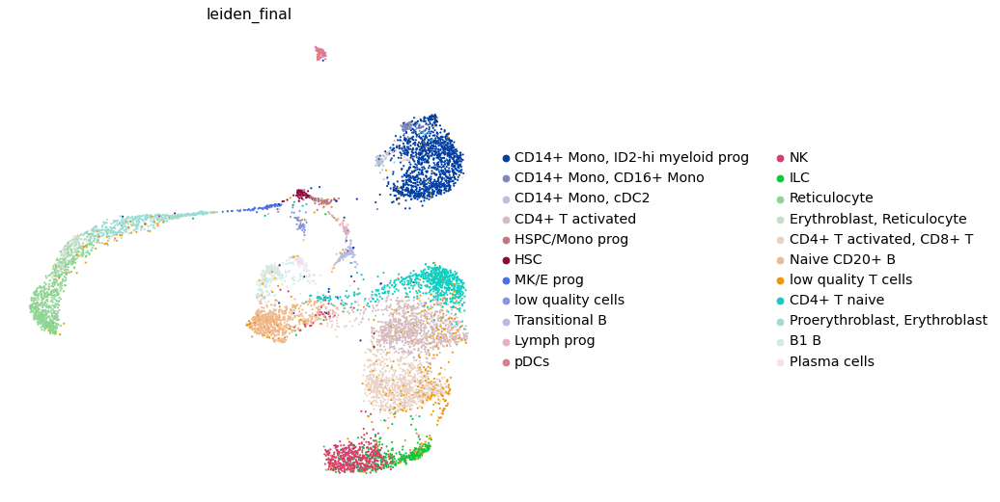

In [353]:
sc.pl.umap(adata_atac_filt, color= ['leiden_final'])

In [354]:
# Updated markes (including new ones for Progenitor clusters)

marker_genes_updated = {
    'CD14+ Mono': ['TREM1', 'FPR1'],
    'CD16+ Mono': ['LYN', 'TCF7L2'],
    'CD14+ Mono prog': ['KLF4'],
    'cDC2': ['TREM1', 'DMXL2'], # Note: DMXL2 should be negative
    'Reticulocyte': ['GATA1', 'HBA1', 'SLC4A1', 'SLC25A37', 'KLF1'],
    'Erythroblast': ['GATA1', 'MKI67'],
    'Proerythroblast': ['GATA2', 'SYNGR1'],
    'NK': ['CD160', 'GNLY', 'GRIK4', 'CD247'],
    'ILC': ['SPON2', 'GZMB', 'PRF1'], # Note CD69 should be negative
    'Lymph prog': ['MME', 'IGLL1', 'VPREB1', 'CD79B'],
    'Naive CD20+ B': ['MS4A1', 'LYN', 'CD74', 'BLK'],
    'B1 B': ['ITGB1', 'MS4A1', 'DUSP22', 'EPHA4'],
    'Transitional B': ['MME', 'CD38', 'CD24'],
    'Plasma cells': ['DUSP22', 'FNDC3B'],
    'CD4+ T activated': ['JAKMIP1', 'C4orf50'],
    'CD4+ T naive': [ 'BCL11B', 'BACH2', 'JAKMIP1', 'C4orf50'], # Note JAKMIP1 and C4orf50 are negative markers
    'CD8+ T': ['CD8A', 'CD8B'],
    'pDCs': ['PTPRS', 'TCF4', 'KCNN3', 'DUSP22'],
    'HSPC/Mono prog': ['MPO', 'NT5DC3'],
    'HSC': ['PRDM16','MTRNR2L1'],
    'MK/E prog': ['DNAJC6'],
    'pro - BORCS5': ['BORCS5', 'RAB31']
}


In [355]:
#Overview
adata_plot = adata_atac_filt.copy()
sc.pp.scale(adata_plot, max_value=4)

Note on marker overview: Compared to the RNA seq markers, the gene activity scores are less distict between clusters. Often markers of multiple subtypes need to be assesed together (E.g.: B1 B and naive CD20+ B cells express very similar set of markers (they are both B cells), but B1 B cells have higher EPHA4 gene activity, therefore distiction can be made)

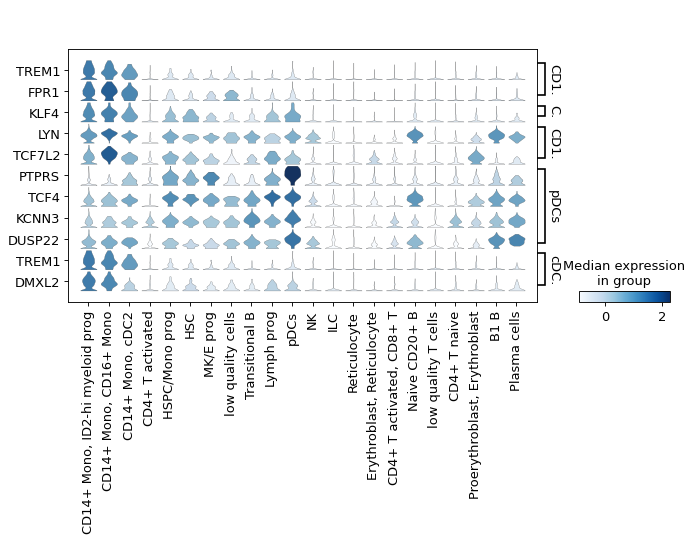

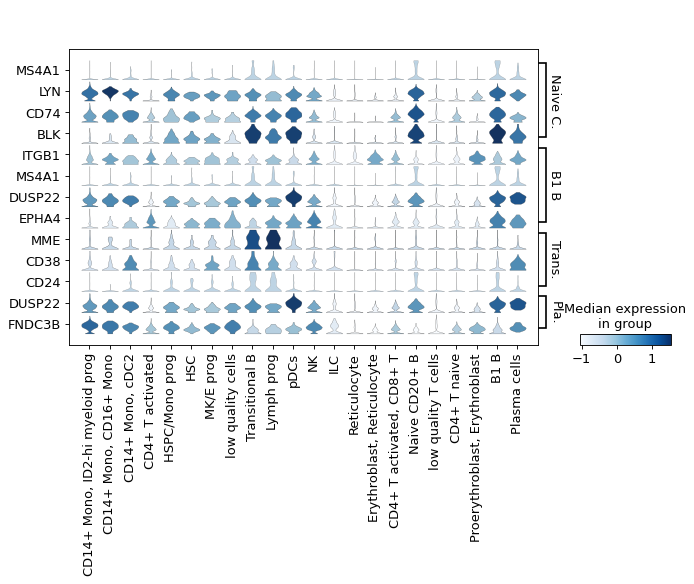

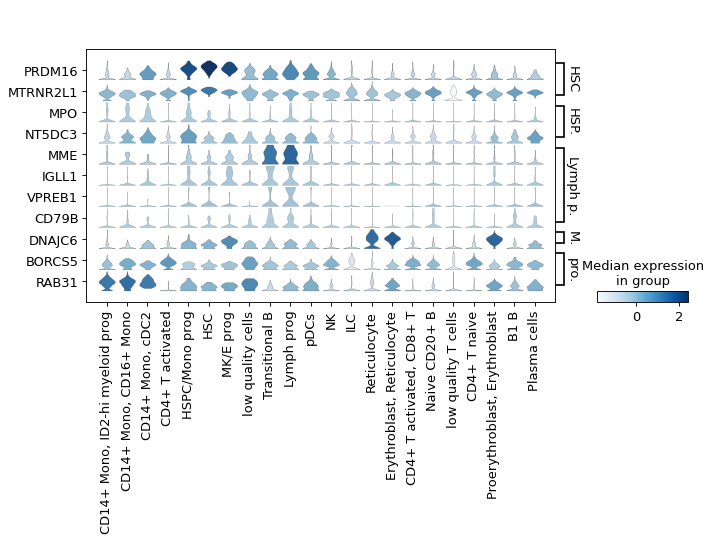

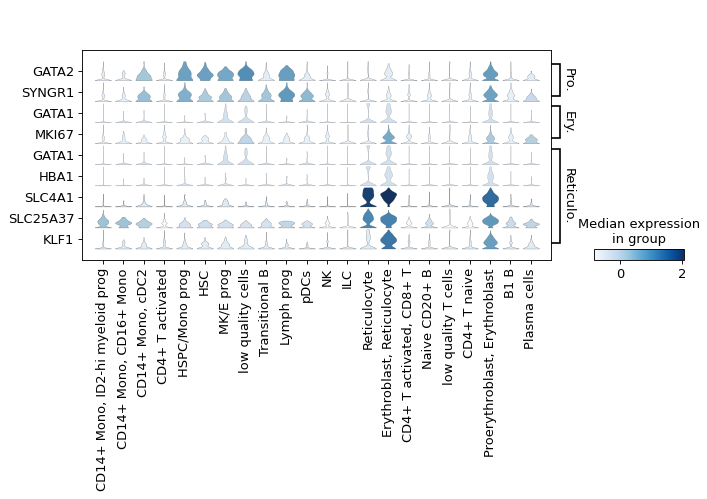

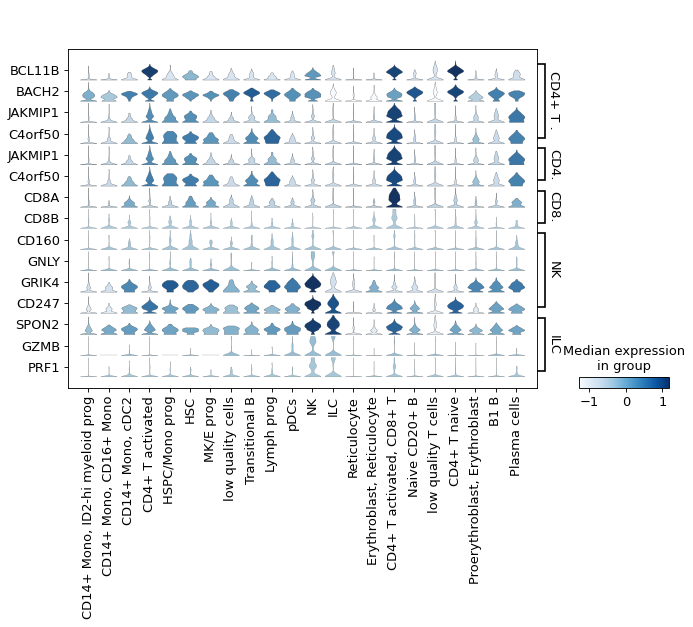

In [356]:
#Monocytes
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['CD14+ Mono', 'CD14+ Mono prog', 'CD16+ Mono', 'pDCs', 'cDC2']})

#B cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells']})

#Progenitors
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['HSC', 'HSPC/Mono prog', 'Lymph prog', 'MK/E prog', 'pro - BORCS5']})

#Erythropoiesis
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['Proerythroblast', 'Erythroblast', 'Reticulocyte']})


#T & NK cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes_updated[a] for a in ['CD4+ T naive', 'CD4+ T activated', 'CD8+ T', 'NK', 'ILC']})

## Write output

In [357]:
adata_atac_filt

AnnData object with n_obs × n_vars = 7985 × 19039
    obs: 'nCount_peaks', 'atac_fragments', 'TSS.enrichment', 'reads_in_peaks_frac', 'blacklist_fraction', 'nucleosome_signal', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'leiden_sub', 'leiden_res0.5_msub', 'leiden_res0.5_msub2', 'leiden_res0.5_tsub1', 'leiden_res0.5_tsub2', 'leiden_res0.5_nsub', 'leiden_res0.5_esub', 'leiden_res0.5_esub2', 'leiden_res0.5_bsub1', 'leiden_res0.5_bsub2', 'leiden_dsub', 'leiden_intermediate1', 'leiden_intermediate2', 'leiden_intermediate3', 'leiden_final', 'leiden_intermediate4'
    uns: 'neighbors', 'leiden', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'rank_genes_res0.5', 'leiden_sub_colors', 'rg_tsub', 'leiden_res0.5_msub_colors', 'rg_msub', 'leiden_res0.5_msub2_colors', 'rg_msub2', 'leiden_res0.5_tsub1_colors', 'rg_tsub1', 'leiden_res0.5_tsub2_colors', 'rg_tsub2', 'leiden_res0.5_nsub_colors', 'rg_nsub', 'leiden_res0.5_esub_colors',

In [358]:
adata_atac_slim = adata_atac_filt.copy()

In [359]:
adata_atac_slim.obs = adata_atac_filt.obs[['nCount_peaks','atac_fragments',
                                     'reads_in_peaks_frac','blacklist_fraction','nucleosome_signal',
                                     'leiden_final']]
del adata_atac_slim.uns
adata_atac_slim.uns['neighbors'] = adata_atac_filt.uns['neighbors']

In [360]:
adata_atac_slim

AnnData object with n_obs × n_vars = 7985 × 19039
    obs: 'nCount_peaks', 'atac_fragments', 'reads_in_peaks_frac', 'blacklist_fraction', 'nucleosome_signal', 'leiden_final'
    uns: 'neighbors'
    obsm: 'lsi_full', 'lsi_red', 'peaks', 'umap'
    obsp: 'distances', 'connectivities'

In [361]:
adata_atac_slim.write_h5ad('donor1_atac.h5ad')